<All keys matched successfully>
총 70개 이미지 발견
사용할 이미지: /home/lkmsdf159/sam-hq/my_images/test/ok/0009.bmp
✅ 이미지 로드 성공: (1600, 1600, 3)
=== 세밀한 선 탐지 시작 ===
반지름 80: 점수 0.977
반지름 120: 점수 0.977
반지름 160: 점수 0.978
반지름 200: 점수 0.978
반지름 240: 점수 0.985


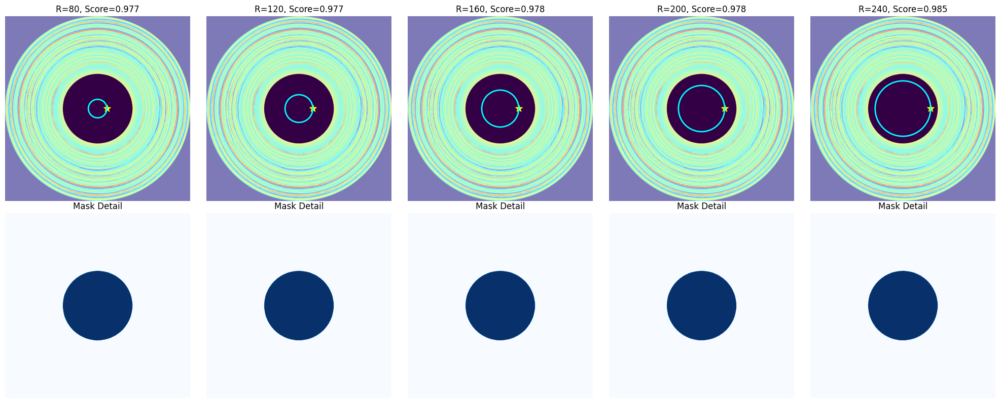

✅ 세밀한 선 탐지 완료!


In [24]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def detect_fine_details_fixed():
    """동심원의 각 선을 세밀하게 탐지 - 수정버전"""
    
    # 모델 로드
    checkpoint_path = "/home/lkmsdf159/sam-hq/pretrained_checkpoint/sam_hq_vit_b.pth"
    sam = sam_model_registry["vit_b"](checkpoint=checkpoint_path)
    predictor = SamPredictor(sam)
    
    # 이미지 찾기 (아까 성공했던 방식)
    ok_path = "/home/lkmsdf159/sam-hq/my_images/test/ok"
    ko_path = "/home/lkmsdf159/sam-hq/my_images/test/ko"
    
    # 모든 이미지 파일 수집
    image_extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG', '.BMP']
    all_images = []
    
    for folder, label in [(ok_path, 'OK'), (ko_path, 'KO')]:
        if os.path.exists(folder):
            files = os.listdir(folder)
            for f in files:
                if any(f.endswith(ext) for ext in image_extensions):
                    full_path = os.path.join(folder, f)
                    all_images.append((full_path, label))
    
    print(f"총 {len(all_images)}개 이미지 발견")
    
    if len(all_images) == 0:
        print("❌ 이미지를 찾을 수 없습니다!")
        # 디렉토리 내용 출력
        print("OK 폴더 내용:")
        if os.path.exists(ok_path):
            print(os.listdir(ok_path)[:10])
        print("KO 폴더 내용:")
        if os.path.exists(ko_path):
            print(os.listdir(ko_path)[:10])
        return
    
    # 첫 번째 이미지 사용
    test_image_path, test_label = all_images[0]
    print(f"사용할 이미지: {test_image_path}")
    
    # 이미지 로드
    image = cv2.imread(test_image_path)
    if image is None:
        print(f"❌ 이미지 로딩 실패: {test_image_path}")
        return
        
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    print(f"✅ 이미지 로드 성공: {image_rgb.shape}")
    
    # 동심원 탐지 시작
    h, w = image_rgb.shape[:2]
    center_x, center_y = w//2, h//2
    
    # 서로 다른 반지름에서 테스트
    test_radii = [80, 120, 160, 200, 240]
    
    plt.figure(figsize=(20, 8))
    
    print("=== 세밀한 선 탐지 시작 ===")
    
    for i, radius in enumerate(test_radii):
        # 해당 반지름에서 포인트 설정
        px = center_x + radius
        py = center_y
        
        input_point = np.array([[px, py]])
        input_label = np.array([1])
        
        # 세그멘테이션 실행
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True
        )
        
        # 가장 좋은 마스크
        best_idx = np.argmax(scores)
        best_mask = masks[best_idx]
        best_score = scores[best_idx]
        
        # 시각화
        plt.subplot(2, len(test_radii), i+1)
        plt.imshow(image_rgb)
        plt.imshow(best_mask, alpha=0.5, cmap='Reds')
        plt.scatter(px, py, color='yellow', s=100, marker='*')
        
        # 참고용 원 표시
        circle = plt.Circle((center_x, center_y), radius, fill=False, color='cyan', linewidth=2)
        plt.gca().add_patch(circle)
        
        plt.title(f'R={radius}, Score={best_score:.3f}')
        plt.axis('off')
        
        # 하단: 마스크만
        plt.subplot(2, len(test_radii), i+1+len(test_radii))
        plt.imshow(best_mask, cmap='Blues')
        plt.title(f'Mask Detail')
        plt.axis('off')
        
        print(f"반지름 {radius}: 점수 {best_score:.3f}")
    
    plt.tight_layout()
    plt.savefig('detailed_line_detection_fixed.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    print("✅ 세밀한 선 탐지 완료!")

# 실행
detect_fine_details_fixed()

탐지된 윤곽선: 12개
윤곽선 8: 원형도 0.896, 중심(804, 797)


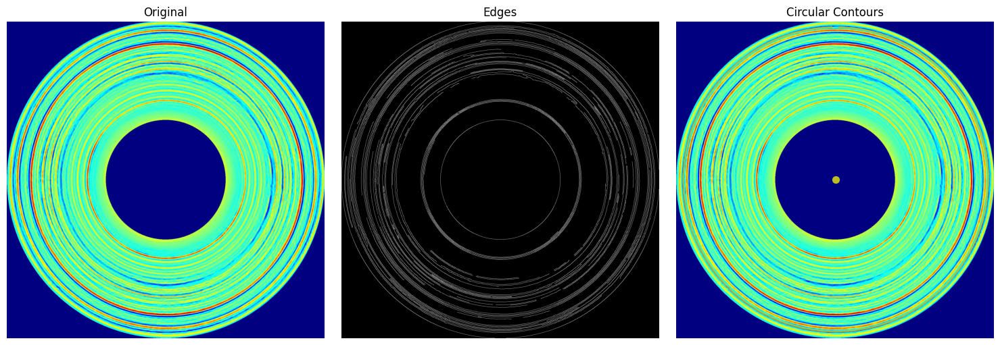

In [ ]:
def contour_based_ring_detection():
    """윤곽선 기반 링 탐지"""
    
    # 이미지 로드
    ok_path = "/home/lkmsdf159/sam-hq/my_images/test/ok"
    files = [f for f in os.listdir(ok_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
    test_image_path = os.path.join(ok_path, files[0])
    
    image = cv2.imread(test_image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # 이미지 전처리
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blurred, 50, 150)
    
    # 윤곽선 찾기
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    plt.figure(figsize=(15, 5))
    
    # 원본
    plt.subplot(1, 3, 1)
    plt.imshow(image_rgb)
    plt.title('Original')
    plt.axis('off')
    
    # 엣지
    plt.subplot(1, 3, 2)
    plt.imshow(edges, cmap='gray')
    plt.title('Edges')
    plt.axis('off')
    
    # 윤곽선들
    plt.subplot(1, 3, 3)
    plt.imshow(image_rgb)
    
    print(f"탐지된 윤곽선: {len(contours)}개")
    
    for i, contour in enumerate(contours[:10]):  
        # 원형도 계산
        area = cv2.contourArea(contour)
        if area > 100:  
            perimeter = cv2.arcLength(contour, True)
            if perimeter > 0:
                circularity = 4 * np.pi * area / (perimeter * perimeter)
                
                if circularity > 0.7: 
                    # 윤곽선 그리기
                    plt.plot(contour[:, 0, 0], contour[:, 0, 1], 
                           color=f'C{i%10}', linewidth=2, alpha=0.8)
                    
                    
                    M = cv2.moments(contour)
                    if M["m00"] != 0:
                        cx = int(M["m10"] / M["m00"])
                        cy = int(M["m01"] / M["m00"])
                        plt.scatter(cx, cy, color=f'C{i%10}', s=50)
                        
                        print(f"윤곽선 {i}: 원형도 {circularity:.3f}, 중심({cx}, {cy})")
    
    plt.title('Circular Contours')
    plt.axis('off')
    
    plt.tight_layout()
    plt.savefig('contour_ring_detection.png', dpi=150, bbox_inches='tight')
    plt.show()

# 실행
contour_based_ring_detection()

=== 새로운 데이터 확인 ===
파일 개수: 30
파일들: ['0023.png', '0002.png', '0019.png', '0005.png', '0026.png']
이미지 크기: (600, 600, 3)
이미지 타입: uint8
픽셀 값 범위: 91 ~ 221


/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 52395 (\N{HANGUL SYLLABLE CEOS}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 48264 (\N{HANGUL SYLLABLE BEON}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 51704 (\N{HANGUL SYLLABLE JJAE}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 51060 (\N{HANGUL SYLLABLE I}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 48120 (\N{HANGUL SYLLABLE MI}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 51648 (\N{HANGUL SYLLABLE JI}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: Glyph 46160 (\N{HANGUL SYLLABLE DU}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_6606/485191433.py:62: UserWarning: 

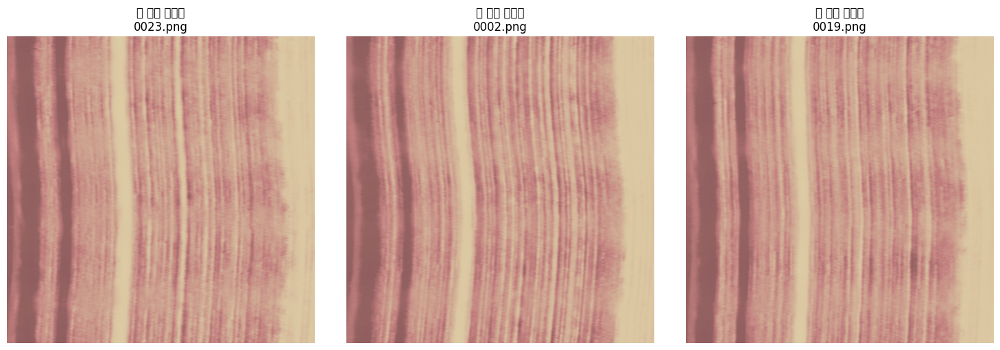


=== 이미지 특성 분석 ===
엣지 밀도: 0.0046
고유 색상 수: 110
대비값: 24.50

=== 추천 세그멘테이션 방법 ===
✅ 복잡한 이미지 → SAM-HQ 포인트 기반 방법 권장


In [38]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def check_and_fix_data():
    """새로운 데이터 확인 및 적절한 방법 적용"""
    
    # 새로운 경로 확인
    new_path = "/home/lkmsdf159/sam-hq/my_images/test/02/test/ok"
    
    print("=== 새로운 데이터 확인 ===")
    if os.path.exists(new_path):
        files = [f for f in os.listdir(new_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
        print(f"파일 개수: {len(files)}")
        print(f"파일들: {files[:5]}")  # 처음 5개만
        
        if files:
            # 첫 번째 이미지 확인
            test_image_path = os.path.join(new_path, files[0])
            image = cv2.imread(test_image_path)
            
            if image is not None:
                image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                
                print(f"이미지 크기: {image_rgb.shape}")
                print(f"이미지 타입: {image.dtype}")
                print(f"픽셀 값 범위: {image_rgb.min()} ~ {image_rgb.max()}")
                
                # 이미지 미리보기
                plt.figure(figsize=(15, 5))
                
                # 첫 번째 이미지
                plt.subplot(1, 3, 1)
                plt.imshow(image_rgb)
                plt.title(f'첫 번째 이미지\n{files[0]}')
                plt.axis('off')
                
                # 두 번째 이미지 (있다면)
                if len(files) > 1:
                    second_image_path = os.path.join(new_path, files[1])
                    second_image = cv2.imread(second_image_path)
                    if second_image is not None:
                        second_image_rgb = cv2.cvtColor(second_image, cv2.COLOR_BGR2RGB)
                        plt.subplot(1, 3, 2)
                        plt.imshow(second_image_rgb)
                        plt.title(f'두 번째 이미지\n{files[1]}')
                        plt.axis('off')
                
                # 세 번째 이미지 (있다면)
                if len(files) > 2:
                    third_image_path = os.path.join(new_path, files[2])
                    third_image = cv2.imread(third_image_path)
                    if third_image is not None:
                        third_image_rgb = cv2.cvtColor(third_image, cv2.COLOR_BGR2RGB)
                        plt.subplot(1, 3, 3)
                        plt.imshow(third_image_rgb)
                        plt.title(f'세 번째 이미지\n{files[2]}')
                        plt.axis('off')
                
                plt.tight_layout()
                plt.savefig('new_data_preview.png', dpi=150, bbox_inches='tight')
                plt.show()
                
                # 이미지 특성 분석
                analyze_image_characteristics(image_rgb)
                
    else:
        print(f"❌ 경로가 존재하지 않습니다: {new_path}")
        
        # 대안 경로들 확인
        alternative_paths = [
            "/home/lkmsdf159/sam-hq/my_images/test/02/ok",
            "/home/lkmsdf159/sam-hq/my_images/test/02",
            "/home/lkmsdf159/sam-hq/my_images/test/ok",
            "/home/lkmsdf159/sam-hq/my_images/02"
        ]
        
        for alt_path in alternative_paths:
            if os.path.exists(alt_path):
                print(f"✅ 대안 경로 발견: {alt_path}")
                break

def analyze_image_characteristics(image_rgb):
    """이미지 특성 분석해서 적절한 세그멘테이션 방법 제안"""
    
    # 그레이스케일 변환
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    # 엣지 탐지
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges > 0) / (edges.shape[0] * edges.shape[1])
    
    # 색상 분포 분석
    unique_colors = len(np.unique(image_rgb.reshape(-1, 3), axis=0))
    
    # 대비 분석
    contrast = gray.std()
    
    print(f"\n=== 이미지 특성 분석 ===")
    print(f"엣지 밀도: {edge_density:.4f}")
    print(f"고유 색상 수: {unique_colors}")
    print(f"대비값: {contrast:.2f}")
    
    # 추천 방법
    print(f"\n=== 추천 세그멘테이션 방법 ===")
    if edge_density > 0.1:
        print("✅ 엣지가 풍부함 → 윤곽선 기반 방법 권장")
    elif contrast > 50:
        print("✅ 대비가 높음 → 임계값 기반 방법 권장")
    elif unique_colors < 50:
        print("✅ 색상이 단순함 → 색상 기반 세그멘테이션 권장")
    else:
        print("✅ 복잡한 이미지 → SAM-HQ 포인트 기반 방법 권장")

# 실행
check_and_fix_data()

<All keys matched successfully>
이미지 크기: 600 x 600
총 35개 관심 포인트 생성
Point 1: (544, 420) - Score: 0.965, Coverage: 63.6%
Point 2: (309, 402) - Score: 0.963, Coverage: 50.2%
Point 3: (127, 12) - Score: 0.951, Coverage: 14.2%
Point 4: (273, 148) - Score: 0.945, Coverage: 29.8%
Point 5: (57, 25) - Score: 0.961, Coverage: 6.3%
Point 6: (463, 129) - Score: 0.953, Coverage: 52.9%
Point 7: (122, 589) - Score: 0.909, Coverage: 15.6%
Point 8: (422, 421) - Score: 0.943, Coverage: 0.5%
Point 9: (451, 565) - Score: 0.946, Coverage: 41.4%
Point 10: (352, 320) - Score: 0.894, Coverage: 2.8%
Point 11: (19, 292) - Score: 0.942, Coverage: 3.1%
Point 12: (21, 338) - Score: 0.948, Coverage: 3.0%


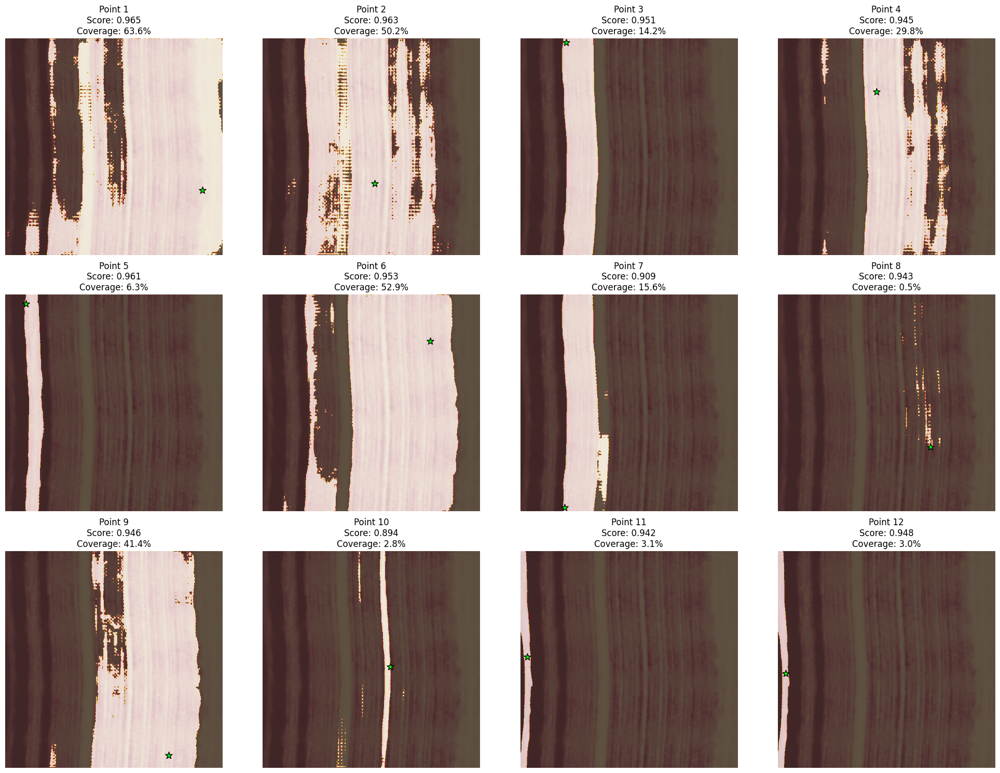


=== 최고 품질 세그멘테이션 결과 ===


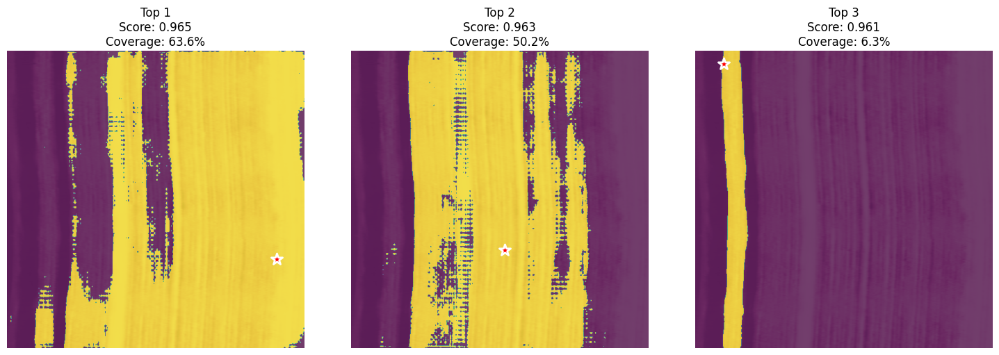

In [39]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def advanced_sam_hq_segmentation():
    """복잡한 이미지를 위한 고급 SAM-HQ 세그멘테이션"""
    
    # 모델 로드
    checkpoint_path = "/home/lkmsdf159/sam-hq/pretrained_checkpoint/sam_hq_vit_b.pth"
    sam = sam_model_registry["vit_b"](checkpoint=checkpoint_path)
    predictor = SamPredictor(sam)
    
    # 새로운 데이터 경로
    data_path = "/home/lkmsdf159/sam-hq/my_images/test/02/test/ok"
    files = [f for f in os.listdir(data_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
    
    # 첫 번째 이미지로 테스트
    test_image_path = os.path.join(data_path, files[0])
    image = cv2.imread(test_image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    
    h, w = image_rgb.shape[:2]
    print(f"이미지 크기: {w} x {h}")
    
    # 1. 자동 관심 지점 찾기
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    # 코너 검출 (Harris Corner)
    corners = cv2.goodFeaturesToTrack(gray, maxCorners=20, qualityLevel=0.01, minDistance=50)
    
    # SIFT 특징점 검출
    sift = cv2.SIFT_create()
    keypoints = sift.detect(gray, None)
    
    # 관심 영역 포인트들
    interest_points = []
    
    # 이미지 격자 포인트
    grid_points = []
    for i in range(3, 8):  # 3x3 ~ 7x7 격자
        for j in range(3, 8):
            x = int(w * i / 10)
            y = int(h * j / 10)
            grid_points.append((x, y))
    
    # 코너 포인트 추가
    if corners is not None:
        corner_points = [(int(x), int(y)) for [[x, y]] in corners[:10]]
        interest_points.extend(corner_points)
    
    # SIFT 키포인트 추가 (상위 10개)
    if keypoints:
        sift_points = [(int(kp.pt[0]), int(kp.pt[1])) for kp in keypoints[:10]]
        interest_points.extend(sift_points)
    
    # 격자 포인트 추가
    interest_points.extend(grid_points[:15])
    
    print(f"총 {len(interest_points)}개 관심 포인트 생성")
    
    # 2. 각 포인트에서 세그멘테이션 수행
    results = []
    
    plt.figure(figsize=(20, 15))
    
    # 처음 12개 포인트만 테스트
    test_points = interest_points[:12]
    
    for i, (px, py) in enumerate(test_points):
        try:
            input_point = np.array([[px, py]])
            input_label = np.array([1])
            
            # 다중 마스크 생성
            masks, scores, logits = predictor.predict(
                point_coords=input_point,
                point_labels=input_label,
                multimask_output=True
            )
            
            # 가장 좋은 마스크 선택
            best_idx = np.argmax(scores)
            best_mask = masks[best_idx]
            best_score = scores[best_idx]
            
            # 마스크 품질 평가
            mask_area = np.sum(best_mask)
            total_area = best_mask.shape[0] * best_mask.shape[1]
            coverage = mask_area / total_area * 100
            
            results.append({
                'point': (px, py),
                'mask': best_mask,
                'score': best_score,
                'coverage': coverage
            })
            
            # 시각화
            plt.subplot(3, 4, i+1)
            plt.imshow(image_rgb)
            plt.imshow(best_mask, alpha=0.6, cmap='hot')
            plt.scatter(px, py, color='lime', s=100, marker='*', edgecolor='black')
            plt.title(f'Point {i+1}\nScore: {best_score:.3f}\nCoverage: {coverage:.1f}%')
            plt.axis('off')
            
            print(f"Point {i+1}: ({px}, {py}) - Score: {best_score:.3f}, Coverage: {coverage:.1f}%")
            
        except Exception as e:
            print(f"Point {i+1} 실패: {e}")
    
    plt.tight_layout()
    plt.savefig('complex_image_segmentation.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # 3. 최고 품질 결과들 선별
    print("\n=== 최고 품질 세그멘테이션 결과 ===")
    
    # 점수 기준 상위 3개
    top_results = sorted(results, key=lambda x: x['score'], reverse=True)[:3]
    
    plt.figure(figsize=(15, 5))
    
    for i, result in enumerate(top_results):
        plt.subplot(1, 3, i+1)
        plt.imshow(image_rgb)
        plt.imshow(result['mask'], alpha=0.7, cmap='viridis')
        
        px, py = result['point']
        plt.scatter(px, py, color='red', s=150, marker='*', edgecolor='white', linewidth=2)
        
        plt.title(f'Top {i+1}\nScore: {result["score"]:.3f}\nCoverage: {result["coverage"]:.1f}%')
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig('top_segmentation_results.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    return results

# 실행
results = advanced_sam_hq_segmentation()

/home/lkmsdf159/sam-hq/segment_anything/build_sam.py:162: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f, map_location=device)


<All keys matched successfully>
이미지 크기: 600 x 600
총 35개 관심 포인트 생성
Point 1: (153, 115) - Score: 0.888, Coverage: 3.9%
Point 2: (37, 591) - Score: 0.775, Coverage: 0.2%
Point 3: (211, 140) - Score: 0.884, Coverage: 1.6%
Point 4: (296, 27) - Score: 0.896, Coverage: 0.6%
Point 5: (237, 3) - Score: 0.859, Coverage: 0.2%
Point 6: (439, 572) - Score: 0.834, Coverage: 0.1%
Point 7: (76, 48) - Score: 0.901, Coverage: 8.6%
Point 8: (217, 75) - Score: 0.899, Coverage: 1.6%
Point 9: (231, 258) - Score: 0.912, Coverage: 1.6%
Point 10: (211, 591) - Score: 0.917, Coverage: 0.1%
Point 11: (26, 35) - Score: 0.942, Coverage: 7.0%
Point 12: (27, 146) - Score: 0.949, Coverage: 7.0%


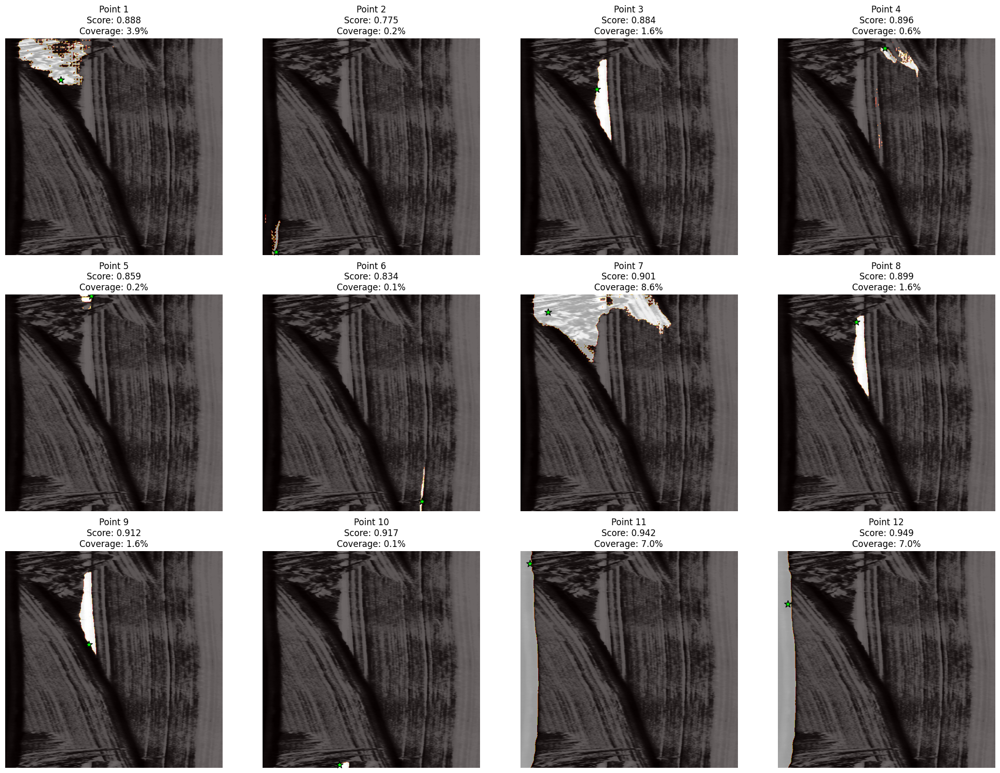


=== 최고 품질 세그멘테이션 결과 ===


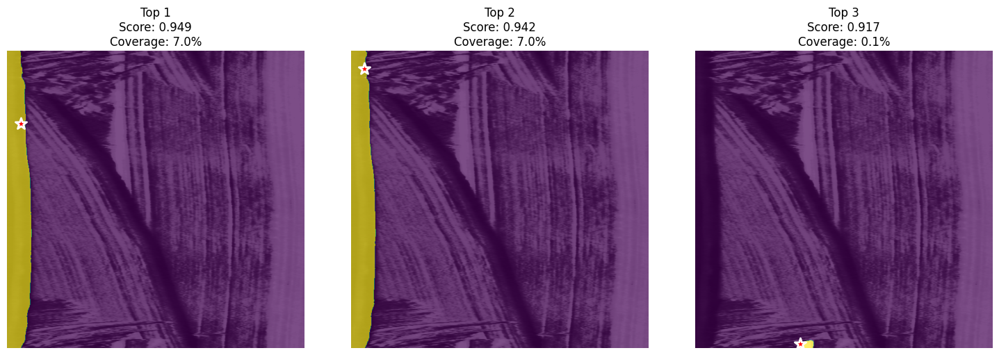

In [74]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def advanced_sam_hq_segmentation():
    """복잡한 이미지를 위한 고급 SAM-HQ 세그멘테이션"""
    

    checkpoint_path = "/home/lkmsdf159/sam-hq/pretrained_checkpoint/sam_hq_vit_b.pth"
    sam = sam_model_registry["vit_b"](checkpoint=checkpoint_path)
    predictor = SamPredictor(sam)
    
    # 단일 이미지 파일 직접 접근
    test_image_path = "/home/lkmsdf159/sam-hq/my_images/test/0008.png"

    # 이미지 로드 및 설정
    image = cv2.imread(test_image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    
    h, w = image_rgb.shape[:2]
    print(f"이미지 크기: {w} x {h}")
    
    # 1. 자동 관심 지점 찾기
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    # 코너 검출 (Harris Corner)
    corners = cv2.goodFeaturesToTrack(gray, maxCorners=20, qualityLevel=0.01, minDistance=50)
    
    # SIFT 특징점 검출
    sift = cv2.SIFT_create()
    keypoints = sift.detect(gray, None)
    
    # 관심 영역 포인트들
    interest_points = []
    
    # 이미지 격자 포인트
    grid_points = []
    for i in range(3, 8):  # 3x3 ~ 7x7 격자
        for j in range(3, 8):
            x = int(w * i / 10)
            y = int(h * j / 10)
            grid_points.append((x, y))
    
    # 코너 포인트 추가
    if corners is not None:
        corner_points = [(int(x), int(y)) for [[x, y]] in corners[:10]]
        interest_points.extend(corner_points)
    
    # SIFT 키포인트 추가 (상위 10개)
    if keypoints:
        sift_points = [(int(kp.pt[0]), int(kp.pt[1])) for kp in keypoints[:10]]
        interest_points.extend(sift_points)
    
    # 격자 포인트 추가
    interest_points.extend(grid_points[:15])
    
    print(f"총 {len(interest_points)}개 관심 포인트 생성")
    
    # 2. 각 포인트에서 세그멘테이션 수행
    results = []
    
    plt.figure(figsize=(20, 15))
    
    # 처음 12개 포인트만 테스트
    test_points = interest_points[:12]
    
    for i, (px, py) in enumerate(test_points):
        try:
            input_point = np.array([[px, py]])
            input_label = np.array([1])
            
            # 다중 마스크 생성
            masks, scores, logits = predictor.predict(
                point_coords=input_point,
                point_labels=input_label,
                multimask_output=True
            )
            
            # 가장 좋은 마스크 선택
            best_idx = np.argmax(scores)
            best_mask = masks[best_idx]
            best_score = scores[best_idx]
            
            # 마스크 품질 평가
            mask_area = np.sum(best_mask)
            total_area = best_mask.shape[0] * best_mask.shape[1]
            coverage = mask_area / total_area * 100
            
            results.append({
                'point': (px, py),
                'mask': best_mask,
                'score': best_score,
                'coverage': coverage
            })
            
            # 시각화
            plt.subplot(3, 4, i+1)
            plt.imshow(image_rgb)
            plt.imshow(best_mask, alpha=0.6, cmap='hot')
            plt.scatter(px, py, color='lime', s=100, marker='*', edgecolor='black')
            plt.title(f'Point {i+1}\nScore: {best_score:.3f}\nCoverage: {coverage:.1f}%')
            plt.axis('off')
            
            print(f"Point {i+1}: ({px}, {py}) - Score: {best_score:.3f}, Coverage: {coverage:.1f}%")
            
        except Exception as e:
            print(f"Point {i+1} 실패: {e}")
    
    plt.tight_layout()
    plt.savefig('complex_image_segmentation.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # 3. 최고 품질 결과들 선별
    print("\n=== 최고 품질 세그멘테이션 결과 ===")
    
    # 점수 기준 상위 3개
    top_results = sorted(results, key=lambda x: x['score'], reverse=True)[:3]
    
    plt.figure(figsize=(15, 5))
    
    for i, result in enumerate(top_results):
        plt.subplot(1, 3, i+1)
        plt.imshow(image_rgb)
        plt.imshow(result['mask'], alpha=0.7, cmap='viridis')
        
        px, py = result['point']
        plt.scatter(px, py, color='red', s=150, marker='*', edgecolor='white', linewidth=2)
        
        plt.title(f'Top {i+1}\nScore: {result["score"]:.3f}\nCoverage: {result["coverage"]:.1f}%')
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig('top_segmentation_results.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    return results

# 실행
results = advanced_sam_hq_segmentation()

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def detect_fine_details():
    """동심원의 각 선을 세밀하게 탐지"""
    
    # 모델 로드
    checkpoint_path = "/home/lkmsdf159/sam-hq/pretrained_checkpoint/sam_hq_vit_b.pth"
    sam = sam_model_registry["vit_b"](checkpoint=checkpoint_path)
    predictor = SamPredictor(sam)
    
    # 이미지 로드
    image_path = "/home/lkmsdf159/sam-hq/my_images/test/ok"
    files = [f for f in os.listdir(image_path) if f.endswith(('.jpg', '.png', '.jpeg'))]
    
    if not files:
        print("이미지가 없습니다!")
        return
        
    test_image = os.path.join(image_path, files[0])
    image = cv2.imread(test_image)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    
    h, w = image_rgb.shape[:2]
    center_x, center_y = w//2, h//2
    
    # 동심원의 각기 다른 반지름에서 세밀한 포인트들
    detailed_points = []
    radii = [60, 90, 120, 150, 180, 210, 240, 270]  # 8개의 서로 다른 반지름
    
    for radius in radii:
        # 각 원둘레에서 여러 각도의 포인트들
        angles = [0, 45, 90, 135, 180, 225, 270, 315]  # 8방향
        for angle in angles:
            rad = np.radians(angle)
            x = int(center_x + radius * np.cos(rad))
            y = int(center_y + radius * np.sin(rad))
            if 0 <= x < w and 0 <= y < h:  # 이미지 범위 내에서만
                detailed_points.append((x, y, radius))
    
    print(f"총 {len(detailed_points)}개 포인트에서 테스트")
    
    # 결과를 저장할 리스트
    results = []
    
    # 각 포인트별로 세그멘테이션 (처음 12개만)
    test_points = detailed_points[:12]  # 너무 많으면 시간이 오래 걸리므로
    
    for i, (px, py, radius) in enumerate(test_points):
        input_point = np.array([[px, py]])
        input_label = np.array([1])
        
        # 다중 마스크로 세밀한 탐지
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True  # 여러 마스크로 세밀도 확인
        )
        
        # 가장 좋은 마스크 선택
        best_idx = np.argmax(scores)
        best_mask = masks[best_idx]
        best_score = scores[best_idx]
        
        results.append({
            'point': (px, py),
            'radius': radius,
            'mask': best_mask,
            'score': best_score,
            'all_masks': masks,
            'all_scores': scores
        })
        
        print(f"포인트 {i+1}/{len(test_points)}: 반지름 {radius}, 점수 {best_score:.3f}")
    
    # 결과 시각화 - 4x3 그리드
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))
    axes = axes.flatten()
    
    for i, result in enumerate(results):
        ax = axes[i]
        
        # 원본 이미지 표시
        ax.imshow(image_rgb)
        
        # 마스크 오버레이
        mask = result['mask']
        colored_mask = np.zeros_like(image_rgb)
        colored_mask[:,:,0] = mask * 255  # 빨간색 채널만
        
        # 반투명 마스크 오버레이
        overlay = cv2.addWeighted(image_rgb, 0.7, colored_mask, 0.3, 0)
        ax.imshow(overlay)
        
        # 클릭한 포인트 표시
        px, py = result['point']
        ax.scatter(px, py, color='yellow', s=100, marker='*', edgecolors='black', linewidth=2)
        
        # 제목 설정
        radius = result['radius']
        score = result['score']
        ax.set_title(f'R={radius}, Score={score:.3f}', fontsize=10, fontweight='bold')
        ax.axis('off')
        
        # 원둘레 표시 (참고용)
        circle = plt.Circle((center_x, center_y), radius, fill=False, color='cyan', linewidth=1, alpha=0.5)
        ax.add_patch(circle)
    
    plt.tight_layout()
    plt.savefig('detailed_line_detection.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # 상세 분석 결과 출력
    print("\n=== 세밀도 분석 결과 ===")
    for i, result in enumerate(results):
        radius = result['radius']
        score = result['score']
        mask = result['mask']
        
        # 마스크 면적 계산
        mask_area = np.sum(mask)
        total_area = mask.shape[0] * mask.shape[1]
        coverage = mask_area / total_area * 100
        
        print(f"반지름 {radius:3d}: 점수 {score:.3f}, 영역 {coverage:.1f}%")
    
    # 마스크 경계 선명도 분석
    print("\n=== 경계 선명도 분석 ===")
    analyze_edge_sharpness(results, image_rgb)

def analyze_edge_sharpness(results, image):
    """마스크 경계의 선명도 분석"""
    for i, result in enumerate(results):
        mask = result['mask'].astype(np.uint8)
        
        # 마스크 경계선 찾기
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if contours:
            # 가장 큰 컨투어 선택
            largest_contour = max(contours, key=cv2.contourArea)
            
            # 경계선 길이
            perimeter = cv2.arcLength(largest_contour, True)
            
            # 영역 대비 경계선 복잡도
            area = cv2.contourArea(largest_contour)
            if area > 0:
                complexity = perimeter / np.sqrt(area)
                print(f"반지름 {result['radius']:3d}: 경계 복잡도 {complexity:.2f}")

# 실행
if __name__ == "__main__":
    detect_fine_details()

<All keys matched successfully>
이미지가 없습니다!


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def detect_fine_details():
    """동심원의 각 선을 세밀하게 탐지"""
    
    # 모델 로드
    checkpoint_path = "/home/lkmsdf159/sam-hq/pretrained_checkpoint/sam_hq_vit_b.pth"
    sam = sam_model_registry["vit_b"](checkpoint=checkpoint_path)
    predictor = SamPredictor(sam)
    
    # 이미지 로드
    image_path = "/home/lkmsdf159/sam-hq/my_images/test/ok"
    files = [f for f in os.listdir(image_path) if f.endswith(('.jpg', '.png', '.jpeg'))]
    
    if not files:
        print("이미지가 없습니다!")
        return
        
    test_image = os.path.join(image_path, files[0])
    image = cv2.imread(test_image)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    
    h, w = image_rgb.shape[:2]
    center_x, center_y = w//2, h//2
    
    # 동심원의 각기 다른 반지름에서 세밀한 포인트들
    detailed_points = []
    radii = [60, 90, 120, 150, 180, 210, 240, 270]  # 8개의 서로 다른 반지름
    
    for radius in radii:
        # 각 원둘레에서 여러 각도의 포인트들
        angles = [0, 45, 90, 135, 180, 225, 270, 315]  # 8방향
        for angle in angles:
            rad = np.radians(angle)
            x = int(center_x + radius * np.cos(rad))
            y = int(center_y + radius * np.sin(rad))
            if 0 <= x < w and 0 <= y < h:  # 이미지 범위 내에서만
                detailed_points.append((x, y, radius))
    
    print(f"총 {len(detailed_points)}개 포인트에서 테스트")
    
    # 결과를 저장할 리스트
    results = []
    
    # 각 포인트별로 세그멘테이션 (처음 12개만)
    test_points = detailed_points[:12]  # 너무 많으면 시간이 오래 걸리므로
    
    for i, (px, py, radius) in enumerate(test_points):
        input_point = np.array([[px, py]])
        input_label = np.array([1])
        
        # 다중 마스크로 세밀한 탐지
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True  # 여러 마스크로 세밀도 확인
        )
        
        # 가장 좋은 마스크 선택
        best_idx = np.argmax(scores)
        best_mask = masks[best_idx]
        best_score = scores[best_idx]
        
        results.append({
            'point': (px, py),
            'radius': radius,
            'mask': best_mask,
            'score': best_score,
            'all_masks': masks,
            'all_scores': scores
        })
        
        print(f"포인트 {i+1}/{len(test_points)}: 반지름 {radius}, 점수 {best_score:.3f}")
    
    # 결과 시각화 - 4x3 그리드
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))
    axes = axes.flatten()
    
    for i, result in enumerate(results):
        ax = axes[i]
        
        # 원본 이미지 표시
        ax.imshow(image_rgb)
        
        # 마스크 오버레이
        mask = result['mask']
        colored_mask = np.zeros_like(image_rgb)
        colored_mask[:,:,0] = mask * 255  # 빨간색 채널만
        
        # 반투명 마스크 오버레이
        overlay = cv2.addWeighted(image_rgb, 0.7, colored_mask, 0.3, 0)
        ax.imshow(overlay)
        
        # 클릭한 포인트 표시
        px, py = result['point']
        ax.scatter(px, py, color='yellow', s=100, marker='*', edgecolors='black', linewidth=2)
        
        # 제목 설정
        radius = result['radius']
        score = result['score']
        ax.set_title(f'R={radius}, Score={score:.3f}', fontsize=10, fontweight='bold')
        ax.axis('off')
        
        # 원둘레 표시 (참고용)
        circle = plt.Circle((center_x, center_y), radius, fill=False, color='cyan', linewidth=1, alpha=0.5)
        ax.add_patch(circle)
    
    plt.tight_layout()
    plt.savefig('detailed_line_detection.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # 상세 분석 결과 출력
    print("\n=== 세밀도 분석 결과 ===")
    for i, result in enumerate(results):
        radius = result['radius']
        score = result['score']
        mask = result['mask']
        
        # 마스크 면적 계산
        mask_area = np.sum(mask)
        total_area = mask.shape[0] * mask.shape[1]
        coverage = mask_area / total_area * 100
        
        print(f"반지름 {radius:3d}: 점수 {score:.3f}, 영역 {coverage:.1f}%")
    
    # 마스크 경계 선명도 분석
    print("\n=== 경계 선명도 분석 ===")
    analyze_edge_sharpness(results, image_rgb)

def analyze_edge_sharpness(results, image):
    """마스크 경계의 선명도 분석"""
    for i, result in enumerate(results):
        mask = result['mask'].astype(np.uint8)
        
        # 마스크 경계선 찾기
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if contours:
            # 가장 큰 컨투어 선택
            largest_contour = max(contours, key=cv2.contourArea)
            
            # 경계선 길이
            perimeter = cv2.arcLength(largest_contour, True)
            
            # 영역 대비 경계선 복잡도
            area = cv2.contourArea(largest_contour)
            if area > 0:
                complexity = perimeter / np.sqrt(area)
                print(f"반지름 {result['radius']:3d}: 경계 복잡도 {complexity:.2f}")

# 실행
if __name__ == "__main__":
    detect_fine_details()

<All keys matched successfully>
이미지가 없습니다!


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import os

def detect_fine_details():
    """동심원의 각 선을 세밀하게 탐지"""
    
    # 모델 로드
    checkpoint_path = "/home/lkmsdf159/sam-hq/pretrained_checkpoint/sam_hq_vit_b.pth"
    sam = sam_model_registry["vit_b"](checkpoint=checkpoint_path)
    predictor = SamPredictor(sam)
    
    # 이미지 로드
    image_path = "/home/lkmsdf159/sam-hq/my_images/test/ok"
    files = [f for f in os.listdir(image_path) if f.endswith(('.jpg', '.png', '.jpeg'))]
    
    if not files:
        print("이미지가 없습니다!")
        return
        
    test_image = os.path.join(image_path, files[0])
    image = cv2.imread(test_image)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    
    h, w = image_rgb.shape[:2]
    center_x, center_y = w//2, h//2
    
    # 동심원의 각기 다른 반지름에서 세밀한 포인트들
    detailed_points = []
    radii = [60, 90, 120, 150, 180, 210, 240, 270]  # 8개의 서로 다른 반지름
    
    for radius in radii:
        # 각 원둘레에서 여러 각도의 포인트들
        angles = [0, 45, 90, 135, 180, 225, 270, 315]  # 8방향
        for angle in angles:
            rad = np.radians(angle)
            x = int(center_x + radius * np.cos(rad))
            y = int(center_y + radius * np.sin(rad))
            if 0 <= x < w and 0 <= y < h:  # 이미지 범위 내에서만
                detailed_points.append((x, y, radius))
    
    print(f"총 {len(detailed_points)}개 포인트에서 테스트")
    
    # 결과를 저장할 리스트
    results = []
    
    # 각 포인트별로 세그멘테이션 (처음 12개만)
    test_points = detailed_points[:12]  # 너무 많으면 시간이 오래 걸리므로
    
    for i, (px, py, radius) in enumerate(test_points):
        input_point = np.array([[px, py]])
        input_label = np.array([1])
        
        # 다중 마스크로 세밀한 탐지
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True  # 여러 마스크로 세밀도 확인
        )
        
        # 가장 좋은 마스크 선택
        best_idx = np.argmax(scores)
        best_mask = masks[best_idx]
        best_score = scores[best_idx]
        
        results.append({
            'point': (px, py),
            'radius': radius,
            'mask': best_mask,
            'score': best_score,
            'all_masks': masks,
            'all_scores': scores
        })
        
        print(f"포인트 {i+1}/{len(test_points)}: 반지름 {radius}, 점수 {best_score:.3f}")
    
    # 결과 시각화 - 4x3 그리드
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))
    axes = axes.flatten()
    
    for i, result in enumerate(results):
        ax = axes[i]
        
        # 원본 이미지 표시
        ax.imshow(image_rgb)
        
        # 마스크 오버레이
        mask = result['mask']
        colored_mask = np.zeros_like(image_rgb)
        colored_mask[:,:,0] = mask * 255  # 빨간색 채널만
        
        # 반투명 마스크 오버레이
        overlay = cv2.addWeighted(image_rgb, 0.7, colored_mask, 0.3, 0)
        ax.imshow(overlay)
        
        # 클릭한 포인트 표시
        px, py = result['point']
        ax.scatter(px, py, color='yellow', s=100, marker='*', edgecolors='black', linewidth=2)
        
        # 제목 설정
        radius = result['radius']
        score = result['score']
        ax.set_title(f'R={radius}, Score={score:.3f}', fontsize=10, fontweight='bold')
        ax.axis('off')
        
        # 원둘레 표시 (참고용)
        circle = plt.Circle((center_x, center_y), radius, fill=False, color='cyan', linewidth=1, alpha=0.5)
        ax.add_patch(circle)
    
    plt.tight_layout()
    plt.savefig('detailed_line_detection.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # 상세 분석 결과 출력
    print("\n=== 세밀도 분석 결과 ===")
    for i, result in enumerate(results):
        radius = result['radius']
        score = result['score']
        mask = result['mask']
        
        # 마스크 면적 계산
        mask_area = np.sum(mask)
        total_area = mask.shape[0] * mask.shape[1]
        coverage = mask_area / total_area * 100
        
        print(f"반지름 {radius:3d}: 점수 {score:.3f}, 영역 {coverage:.1f}%")
    
    # 마스크 경계 선명도 분석
    print("\n=== 경계 선명도 분석 ===")
    analyze_edge_sharpness(results, image_rgb)

def analyze_edge_sharpness(results, image):
    """마스크 경계의 선명도 분석"""
    for i, result in enumerate(results):
        mask = result['mask'].astype(np.uint8)
        
        # 마스크 경계선 찾기
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if contours:
            # 가장 큰 컨투어 선택
            largest_contour = max(contours, key=cv2.contourArea)
            
            # 경계선 길이
            perimeter = cv2.arcLength(largest_contour, True)
            
            # 영역 대비 경계선 복잡도
            area = cv2.contourArea(largest_contour)
            if area > 0:
                complexity = perimeter / np.sqrt(area)
                print(f"반지름 {result['radius']:3d}: 경계 복잡도 {complexity:.2f}")

# 실행
if __name__ == "__main__":
    detect_fine_details()

<All keys matched successfully>
이미지가 없습니다!


이미지 크기: (600, 600, 3)
감지된 세로선: 4개
투영 피크: 40개


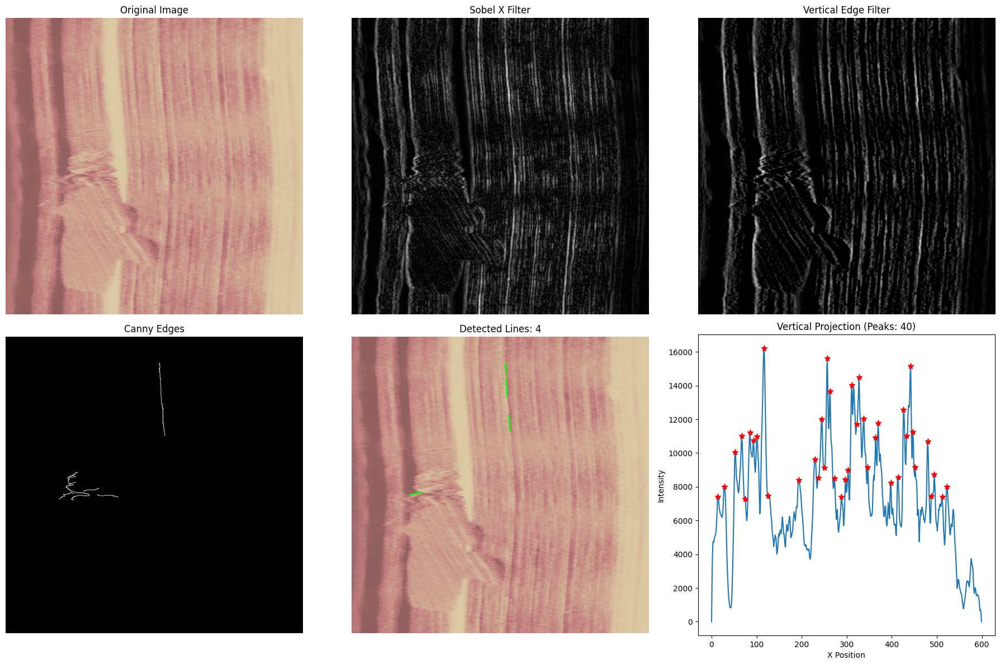

In [45]:
# 목재 결 패턴 감지 - 셀 1
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

# 이미지 로드
image_path = '/home/lkmsdf159/sam-hq/my_images/test/02/test/ko/0009.png'
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

print(f"이미지 크기: {image_rgb.shape}")

# 전처리
blurred = cv2.GaussianBlur(gray, (3, 3), 0)

# 방법 1: Sobel X 필터 (세로선 강조)
sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
sobelx_norm = np.uint8(np.absolute(sobelx))

# 방법 2: 방향성 필터
vertical_kernel = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
vertical_edges = cv2.filter2D(blurred, -1, vertical_kernel)
vertical_edges = np.uint8(np.absolute(vertical_edges))

# 방법 3: 허프 변환으로 직선 감지
edges = cv2.Canny(blurred, 50, 150)
lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=30, 
                       minLineLength=20, maxLineGap=5)

# 세로선 필터링
line_image = image_rgb.copy()
vertical_lines = []

if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        if x2 - x1 != 0:
            angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
            # 세로선 조건 (각도가 70도 이상)
            if abs(angle) > 70 or abs(angle) < 20:
                vertical_lines.append(line)
                cv2.line(line_image, (x1, y1), (x2, y2), (0, 255, 0), 2)

# 세로 방향 투영으로 결 밀도 분석
vertical_projection = np.sum(sobelx_norm, axis=0)
peaks, _ = find_peaks(vertical_projection, height=np.mean(vertical_projection), distance=5)

print(f"감지된 세로선: {len(vertical_lines)}개")
print(f"투영 피크: {len(peaks)}개")

# 결과 시각화
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title('Original Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(sobelx_norm, cmap='gray')
axes[0, 1].set_title('Sobel X Filter')
axes[0, 1].axis('off')

axes[0, 2].imshow(vertical_edges, cmap='gray')
axes[0, 2].set_title('Vertical Edge Filter')
axes[0, 2].axis('off')

axes[1, 0].imshow(edges, cmap='gray')
axes[1, 0].set_title('Canny Edges')
axes[1, 0].axis('off')

axes[1, 1].imshow(line_image)
axes[1, 1].set_title(f'Detected Lines: {len(vertical_lines)}')
axes[1, 1].axis('off')

axes[1, 2].plot(vertical_projection)
axes[1, 2].plot(peaks, vertical_projection[peaks], 'r*', markersize=8)
axes[1, 2].set_title(f'Vertical Projection (Peaks: {len(peaks)})')
axes[1, 2].set_xlabel('X Position')
axes[1, 2].set_ylabel('Intensity')

plt.tight_layout()
plt.show()

이미지 크기: (600, 600, 3)
감지된 세로선: 21개
투영 피크: 45개


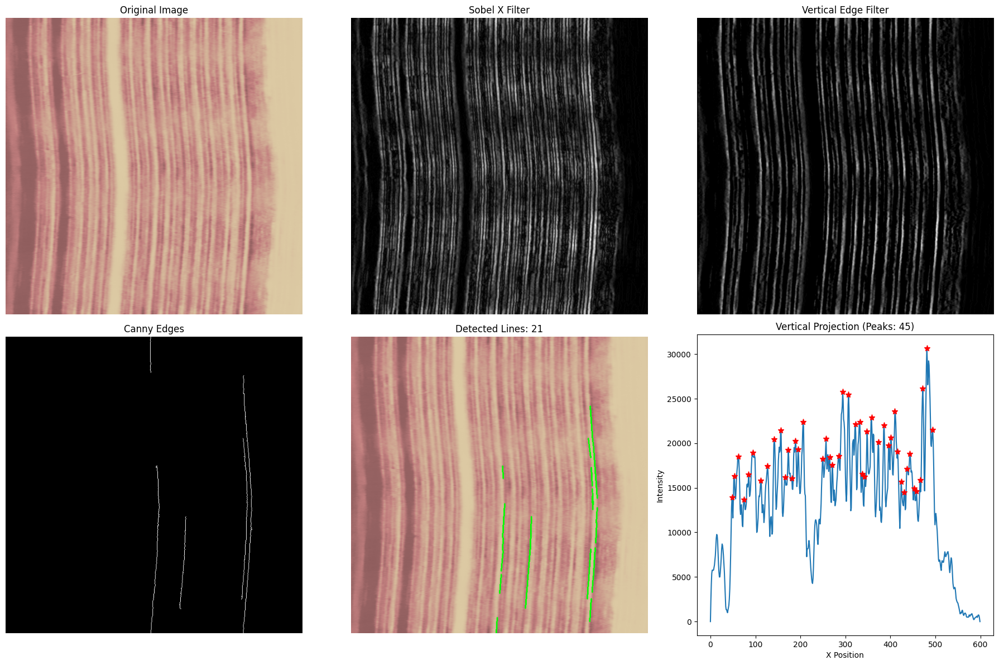

In [43]:
# 목재 결 패턴 감지 - 셀 1
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

# 이미지 로드
image_path = '/home/lkmsdf159/sam-hq/my_images/test/02/test/ok/0003.png'
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

print(f"이미지 크기: {image_rgb.shape}")

# 전처리
blurred = cv2.GaussianBlur(gray, (3, 3), 0)

# 방법 1: Sobel X 필터 (세로선 강조)
sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
sobelx_norm = np.uint8(np.absolute(sobelx))

# 방법 2: 방향성 필터
vertical_kernel = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
vertical_edges = cv2.filter2D(blurred, -1, vertical_kernel)
vertical_edges = np.uint8(np.absolute(vertical_edges))

# 방법 3: 허프 변환으로 직선 감지
edges = cv2.Canny(blurred, 50, 150)
lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=30, 
                       minLineLength=20, maxLineGap=5)

# 세로선 필터링
line_image = image_rgb.copy()
vertical_lines = []

if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        if x2 - x1 != 0:
            angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
            # 세로선 조건 (각도가 70도 이상)
            if abs(angle) > 70 or abs(angle) < 20:
                vertical_lines.append(line)
                cv2.line(line_image, (x1, y1), (x2, y2), (0, 255, 0), 2)

# 세로 방향 투영으로 결 밀도 분석
vertical_projection = np.sum(sobelx_norm, axis=0)
peaks, _ = find_peaks(vertical_projection, height=np.mean(vertical_projection), distance=5)

print(f"감지된 세로선: {len(vertical_lines)}개")
print(f"투영 피크: {len(peaks)}개")

# 결과 시각화
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title('Original Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(sobelx_norm, cmap='gray')
axes[0, 1].set_title('Sobel X Filter')
axes[0, 1].axis('off')

axes[0, 2].imshow(vertical_edges, cmap='gray')
axes[0, 2].set_title('Vertical Edge Filter')
axes[0, 2].axis('off')

axes[1, 0].imshow(edges, cmap='gray')
axes[1, 0].set_title('Canny Edges')
axes[1, 0].axis('off')

axes[1, 1].imshow(line_image)
axes[1, 1].set_title(f'Detected Lines: {len(vertical_lines)}')
axes[1, 1].axis('off')

axes[1, 2].plot(vertical_projection)
axes[1, 2].plot(peaks, vertical_projection[peaks], 'r*', markersize=8)
axes[1, 2].set_title(f'Vertical Projection (Peaks: {len(peaks)})')
axes[1, 2].set_xlabel('X Position')
axes[1, 2].set_ylabel('Intensity')

plt.tight_layout()
plt.show()

=== 상세 분석 결과 ===
감지된 결 개수: 0
평균 결 간격: 0.00 pixels
결 균일성: 0.000 (1이 완벽)
방향 일관성: 0.908 (1이 완벽)
결 품질 점수: 0.000


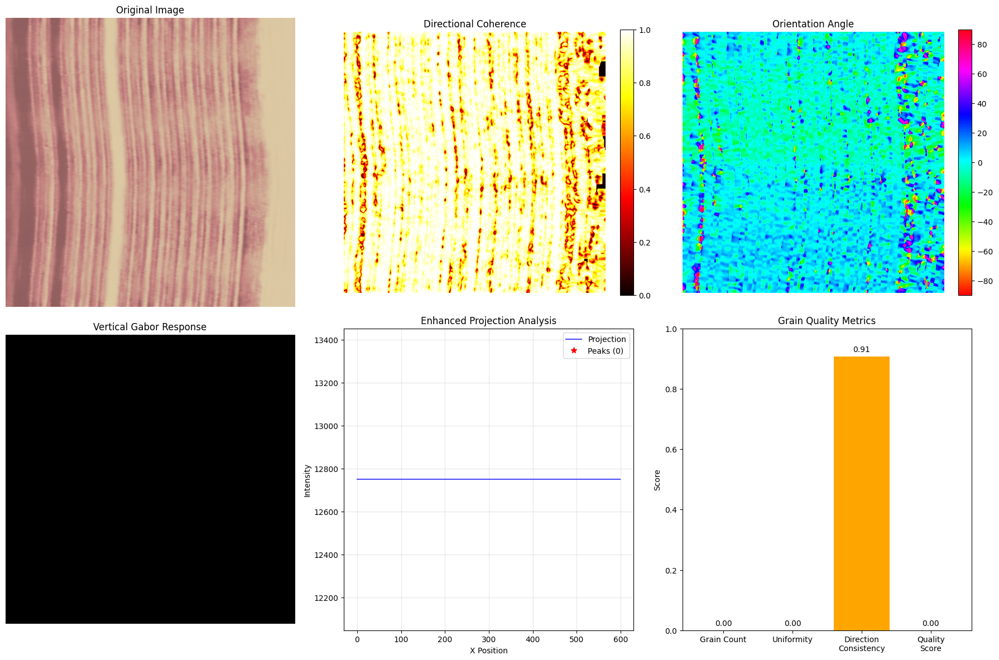

In [47]:
# 개선된 목재 결 분석 - 더 정확한 감지
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from scipy import ndimage

def analyze_wood_grain_detailed(image_path):
    # 이미지 로드
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    # 전처리 - 더 강한 노이즈 제거
    denoised = cv2.bilateralFilter(gray, 9, 75, 75)
    
    # 1. 방향성 분석 (구조 텐서)
    # 그래디언트 계산
    Ix = cv2.Sobel(denoised, cv2.CV_64F, 1, 0, ksize=3)
    Iy = cv2.Sobel(denoised, cv2.CV_64F, 0, 1, ksize=3)
    
    # 구조 텐서
    Ixx = cv2.GaussianBlur(Ix * Ix, (0, 0), 2.0)
    Ixy = cv2.GaussianBlur(Ix * Iy, (0, 0), 2.0)
    Iyy = cv2.GaussianBlur(Iy * Iy, (0, 0), 2.0)
    
    # 고유값과 고유벡터 계산
    trace = Ixx + Iyy
    det = Ixx * Iyy - Ixy * Ixy
    
    # 두 고유값
    lambda1 = 0.5 * (trace + np.sqrt(trace**2 - 4*det))
    lambda2 = 0.5 * (trace - np.sqrt(trace**2 - 4*det))
    
    # 방향성 강도 (coherence)
    coherence = (lambda1 - lambda2) / (lambda1 + lambda2 + 1e-10)
    coherence = np.clip(coherence, 0, 1)
    
    # 주 방향각 계산
    orientation = 0.5 * np.arctan2(2*Ixy, Ixx - Iyy)
    
    # 2. 가버 필터 뱅크로 방향성 분석
    def gabor_responses(image, num_orientations=8):
        responses = []
        for i in range(num_orientations):
            theta = i * np.pi / num_orientations
            kernel = cv2.getGaborKernel((21, 21), 3, theta, 8, 0.5, 0)
            response = cv2.filter2D(image, cv2.CV_8UC3, kernel)
            responses.append(response)
        return responses
    
    gabor_filters = gabor_responses(denoised)
    
    # 세로 방향 (90도) 가버 필터 응답이 가장 강한 영역
    vertical_response = gabor_filters[4]  # 90도 방향
    
    # 3. 향상된 투영 분석
    # 여러 높이에서 수평 투영
    h, w = gray.shape
    projections = []
    
    for row_start in range(0, h-50, 50):
        row_end = min(row_start + 50, h)
        region = vertical_response[row_start:row_end, :]
        projection = np.sum(region, axis=0)
        projections.append(projection)
    
    # 평균 투영
    avg_projection = np.mean(projections, axis=0)
    
    # 적응적 피크 감지
    prominence = np.std(avg_projection) * 0.3
    peaks, properties = find_peaks(avg_projection, 
                                  height=np.mean(avg_projection),
                                  prominence=prominence,
                                  distance=3)
    
    # 4. 결 간격 분석
    if len(peaks) > 1:
        grain_spacings = np.diff(peaks)
        avg_grain_spacing = np.mean(grain_spacings)
        grain_uniformity = 1 - (np.std(grain_spacings) / avg_grain_spacing)
    else:
        avg_grain_spacing = 0
        grain_uniformity = 0
    
    # 5. 결 방향 일관성 분석
    # 세로 방향에 얼마나 가까운지
    orientation_deg = orientation * 180 / np.pi
    vertical_deviation = np.abs(np.mod(orientation_deg + 90, 180) - 90)
    direction_consistency = np.mean(coherence[vertical_deviation < 20])
    
    results = {
        'original': image_rgb,
        'coherence': coherence,
        'orientation': orientation_deg,
        'vertical_response': vertical_response,
        'avg_projection': avg_projection,
        'peaks': peaks,
        'peak_heights': avg_projection[peaks],
        'num_grains': len(peaks),
        'avg_grain_spacing': avg_grain_spacing,
        'grain_uniformity': grain_uniformity,
        'direction_consistency': direction_consistency,
        'grain_quality_score': grain_uniformity * direction_consistency
    }
    
    return results

# 두 이미지 분석
image1_path = '/home/lkmsdf159/sam-hq/my_images/test/02/test/ok/0003.png'
image2_path = '/home/lkmsdf159/sam-hq/my_images/test/02/test/ok/0003.png'  # 같은 이미지인지 확인

results1 = analyze_wood_grain_detailed(image1_path)

print("=== 상세 분석 결과 ===")
print(f"감지된 결 개수: {results1['num_grains']}")
print(f"평균 결 간격: {results1['avg_grain_spacing']:.2f} pixels")
print(f"결 균일성: {results1['grain_uniformity']:.3f} (1이 완벽)")
print(f"방향 일관성: {results1['direction_consistency']:.3f} (1이 완벽)")
print(f"결 품질 점수: {results1['grain_quality_score']:.3f}")

# 시각화
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# 원본
axes[0, 0].imshow(results1['original'])
axes[0, 0].set_title('Original Image')
axes[0, 0].axis('off')

# 방향성 강도 (coherence)
im1 = axes[0, 1].imshow(results1['coherence'], cmap='hot', vmin=0, vmax=1)
axes[0, 1].set_title('Directional Coherence')
axes[0, 1].axis('off')
plt.colorbar(im1, ax=axes[0, 1], fraction=0.046)

# 방향각
im2 = axes[0, 2].imshow(results1['orientation'], cmap='hsv', vmin=-90, vmax=90)
axes[0, 2].set_title('Orientation Angle')
axes[0, 2].axis('off')
plt.colorbar(im2, ax=axes[0, 2], fraction=0.046)

# 가버 필터 응답 (세로 방향)
axes[1, 0].imshow(results1['vertical_response'], cmap='gray')
axes[1, 0].set_title('Vertical Gabor Response')
axes[1, 0].axis('off')

# 향상된 투영 분석
axes[1, 1].plot(results1['avg_projection'], 'b-', alpha=0.7, label='Projection')
axes[1, 1].plot(results1['peaks'], results1['peak_heights'], 'r*', 
                markersize=8, label=f'Peaks ({len(results1["peaks"])})')
axes[1, 1].set_title('Enhanced Projection Analysis')
axes[1, 1].set_xlabel('X Position')
axes[1, 1].set_ylabel('Intensity')
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)

# 결 품질 메트릭
metrics = ['Grain Count', 'Uniformity', 'Direction\nConsistency', 'Quality\nScore']
values = [results1['num_grains']/50, results1['grain_uniformity'], 
          results1['direction_consistency'], results1['grain_quality_score']]

bars = axes[1, 2].bar(metrics, values, color=['skyblue', 'lightgreen', 'orange', 'salmon'])
axes[1, 2].set_title('Grain Quality Metrics')
axes[1, 2].set_ylabel('Score')
axes[1, 2].set_ylim(0, 1)

# 값 표시
for bar, value in zip(bars, values):
    height = bar.get_height()
    axes[1, 2].text(bar.get_x() + bar.get_width()/2., height + 0.01,
                    f'{value:.2f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

이미지 크기: (1600, 1600, 3)
허프 변환으로 감지된 원: 3935개
원형 윤곽선: 6개


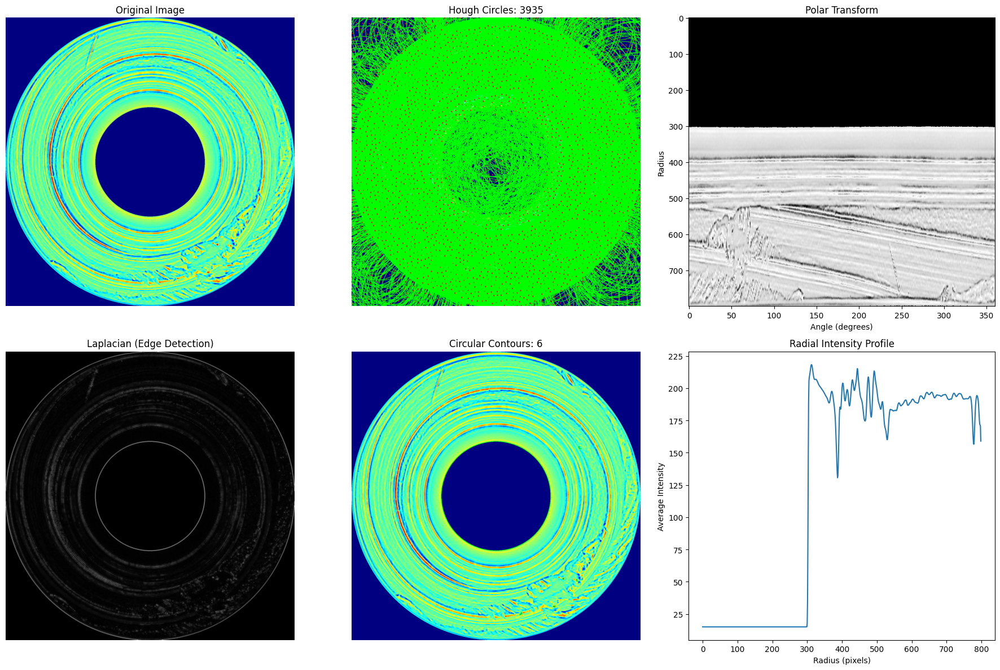


감지된 원들:
Circle 1: Center=(806, 812), Radius=787
Circle 2: Center=(806, 766), Radius=749
Circle 3: Center=(834, 766), Radius=752
Circle 4: Center=(792, 794), Radius=790
Circle 5: Center=(828, 796), Radius=614
Circle 6: Center=(768, 804), Radius=706
Circle 7: Center=(804, 746), Radius=721
Circle 8: Center=(782, 738), Radius=734
Circle 9: Center=(826, 744), Radius=738
Circle 10: Center=(754, 824), Radius=676
Circle 11: Center=(780, 774), Radius=699
Circle 12: Center=(848, 800), Radius=612
Circle 13: Center=(790, 824), Radius=644
Circle 14: Center=(828, 816), Radius=610
Circle 15: Center=(720, 838), Radius=712
Circle 16: Center=(852, 828), Radius=623
Circle 17: Center=(758, 870), Radius=720
Circle 18: Center=(778, 850), Radius=664
Circle 19: Center=(778, 894), Radius=705
Circle 20: Center=(824, 722), Radius=712
Circle 21: Center=(828, 842), Radius=637
Circle 22: Center=(850, 778), Radius=604
Circle 23: Center=(808, 842), Radius=648
Circle 24: Center=(760, 760), Radius=542
Circle 25: Cente

In [42]:
# 동심원 패턴 감지 - 셀 2
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 이미지 로드
image_path = '/home/lkmsdf159/sam-hq/my_images/test/ko/ko/0015.bmp'
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

print(f"이미지 크기: {image_rgb.shape}")

# 전처리
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# 방법 1: 허프 원 변환
circles = cv2.HoughCircles(blurred, cv2.HOUGH_GRADIENT, dp=1, 
                          minDist=20, param1=50, param2=30, 
                          minRadius=5, maxRadius=min(gray.shape)//2)

circle_image = image_rgb.copy()
detected_circles = []

if circles is not None:
    circles = np.round(circles[0, :]).astype("int")
    for (x, y, r) in circles:
        detected_circles.append((x, y, r))
        cv2.circle(circle_image, (x, y), r, (0, 255, 0), 2)
        cv2.circle(circle_image, (x, y), 2, (255, 0, 0), 3)

# 방법 2: 극좌표 변환
def cartesian_to_polar(image, center):
    h, w = image.shape
    max_radius = min(h, w) // 2
    
    polar_image = np.zeros((max_radius, 360))
    
    for r in range(max_radius):
        for theta_idx in range(360):
            theta = theta_idx * np.pi / 180
            x = int(center[0] + r * np.cos(theta))
            y = int(center[1] + r * np.sin(theta))
            
            if 0 <= x < w and 0 <= y < h:
                polar_image[r, theta_idx] = image[y, x]
    
    return polar_image

center = (gray.shape[1]//2, gray.shape[0]//2)
polar_image = cartesian_to_polar(gray, center)

# 방법 3: 라플라시안으로 원형 경계 감지
laplacian = cv2.Laplacian(blurred, cv2.CV_64F, ksize=3)
laplacian_abs = np.uint8(np.absolute(laplacian))

# 방법 4: 윤곽선 기반 원형 감지
edges = cv2.Canny(blurred, 50, 150)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

contour_image = image_rgb.copy()
circular_contours = []

for contour in contours:
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    
    if area > 50:  # 최소 면적 조건
        # 원형도 계산
        circularity = 4 * np.pi * area / (perimeter * perimeter + 1e-10)
        
        if circularity > 0.5:  # 원형도 임계값
            circular_contours.append(contour)
            cv2.drawContours(contour_image, [contour], -1, (0, 255, 0), 2)

# 방법 5: 중심에서 반지름별 강도 분석
def radial_profile(image, center):
    h, w = image.shape
    max_radius = min(center[0], center[1], w-center[0], h-center[1])
    
    radial_intensity = []
    for r in range(1, max_radius):
        mask = np.zeros((h, w), dtype=np.uint8)
        cv2.circle(mask, center, r, 255, 1)
        
        intensity = np.mean(image[mask == 255])
        radial_intensity.append(intensity)
    
    return radial_intensity

radial_profile_data = radial_profile(blurred, center)

print(f"허프 변환으로 감지된 원: {len(detected_circles)}개")
print(f"원형 윤곽선: {len(circular_contours)}개")

# 결과 시각화
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title('Original Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(circle_image)
axes[0, 1].set_title(f'Hough Circles: {len(detected_circles)}')
axes[0, 1].axis('off')

axes[0, 2].imshow(polar_image, cmap='gray', aspect='auto')
axes[0, 2].set_title('Polar Transform')
axes[0, 2].set_xlabel('Angle (degrees)')
axes[0, 2].set_ylabel('Radius')

axes[1, 0].imshow(laplacian_abs, cmap='gray')
axes[1, 0].set_title('Laplacian (Edge Detection)')
axes[1, 0].axis('off')

axes[1, 1].imshow(contour_image)
axes[1, 1].set_title(f'Circular Contours: {len(circular_contours)}')
axes[1, 1].axis('off')

axes[1, 2].plot(radial_profile_data)
axes[1, 2].set_title('Radial Intensity Profile')
axes[1, 2].set_xlabel('Radius (pixels)')
axes[1, 2].set_ylabel('Average Intensity')

plt.tight_layout()
plt.show()

# 감지된 원들의 정보 출력
if detected_circles:
    print("\n감지된 원들:")
    for i, (x, y, r) in enumerate(detected_circles):
        print(f"Circle {i+1}: Center=({x}, {y}), Radius={r}")
else:
    print("감지된 원이 없습니다.")

이미지 크기: (1600, 1600, 3)
허프 변환으로 감지된 원: 4028개
원형 윤곽선: 1개


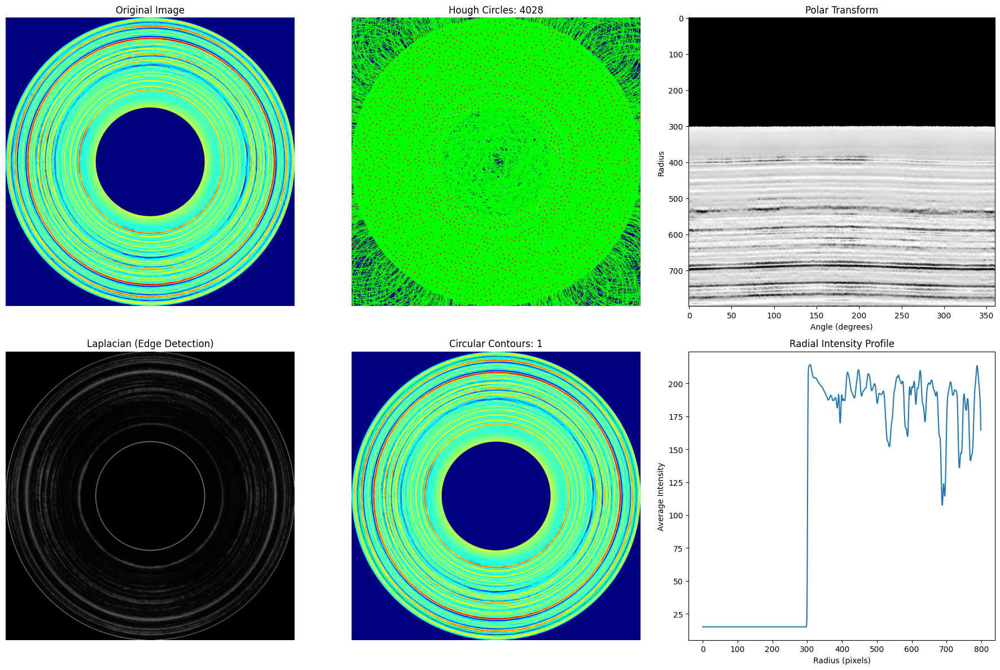


감지된 원들:
Circle 1: Center=(804, 798), Radius=737
Circle 2: Center=(786, 774), Radius=772
Circle 3: Center=(822, 810), Radius=763
Circle 4: Center=(788, 818), Radius=778
Circle 5: Center=(820, 786), Radius=776
Circle 6: Center=(778, 796), Radius=769
Circle 7: Center=(842, 796), Radius=722
Circle 8: Center=(806, 768), Radius=768
Circle 9: Center=(814, 834), Radius=722
Circle 10: Center=(838, 844), Radius=742
Circle 11: Center=(764, 776), Radius=730
Circle 12: Center=(738, 808), Radius=720
Circle 13: Center=(832, 764), Radius=732
Circle 14: Center=(758, 810), Radius=716
Circle 15: Center=(774, 832), Radius=758
Circle 16: Center=(798, 848), Radius=709
Circle 17: Center=(708, 810), Radius=693
Circle 18: Center=(800, 746), Radius=717
Circle 19: Center=(836, 824), Radius=707
Circle 20: Center=(858, 812), Radius=715
Circle 21: Center=(764, 756), Radius=690
Circle 22: Center=(858, 840), Radius=681
Circle 23: Center=(770, 852), Radius=739
Circle 24: Center=(864, 786), Radius=734
Circle 25: Cente

In [44]:
# 동심원 패턴 감지 - 셀 2
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 이미지 로드
image_path = '/home/lkmsdf159/sam-hq/my_images/test/ok/0009.bmp'
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

print(f"이미지 크기: {image_rgb.shape}")

# 전처리
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# 방법 1: 허프 원 변환
circles = cv2.HoughCircles(blurred, cv2.HOUGH_GRADIENT, dp=1, 
                          minDist=20, param1=50, param2=30, 
                          minRadius=5, maxRadius=min(gray.shape)//2)

circle_image = image_rgb.copy()
detected_circles = []

if circles is not None:
    circles = np.round(circles[0, :]).astype("int")
    for (x, y, r) in circles:
        detected_circles.append((x, y, r))
        cv2.circle(circle_image, (x, y), r, (0, 255, 0), 2)
        cv2.circle(circle_image, (x, y), 2, (255, 0, 0), 3)

# 방법 2: 극좌표 변환
def cartesian_to_polar(image, center):
    h, w = image.shape
    max_radius = min(h, w) // 2
    
    polar_image = np.zeros((max_radius, 360))
    
    for r in range(max_radius):
        for theta_idx in range(360):
            theta = theta_idx * np.pi / 180
            x = int(center[0] + r * np.cos(theta))
            y = int(center[1] + r * np.sin(theta))
            
            if 0 <= x < w and 0 <= y < h:
                polar_image[r, theta_idx] = image[y, x]
    
    return polar_image

center = (gray.shape[1]//2, gray.shape[0]//2)
polar_image = cartesian_to_polar(gray, center)

# 방법 3: 라플라시안으로 원형 경계 감지
laplacian = cv2.Laplacian(blurred, cv2.CV_64F, ksize=3)
laplacian_abs = np.uint8(np.absolute(laplacian))

# 방법 4: 윤곽선 기반 원형 감지
edges = cv2.Canny(blurred, 50, 150)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

contour_image = image_rgb.copy()
circular_contours = []

for contour in contours:
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    
    if area > 50:  # 최소 면적 조건
        # 원형도 계산
        circularity = 4 * np.pi * area / (perimeter * perimeter + 1e-10)
        
        if circularity > 0.5:  # 원형도 임계값
            circular_contours.append(contour)
            cv2.drawContours(contour_image, [contour], -1, (0, 255, 0), 2)

# 방법 5: 중심에서 반지름별 강도 분석
def radial_profile(image, center):
    h, w = image.shape
    max_radius = min(center[0], center[1], w-center[0], h-center[1])
    
    radial_intensity = []
    for r in range(1, max_radius):
        mask = np.zeros((h, w), dtype=np.uint8)
        cv2.circle(mask, center, r, 255, 1)
        
        intensity = np.mean(image[mask == 255])
        radial_intensity.append(intensity)
    
    return radial_intensity

radial_profile_data = radial_profile(blurred, center)

print(f"허프 변환으로 감지된 원: {len(detected_circles)}개")
print(f"원형 윤곽선: {len(circular_contours)}개")

# 결과 시각화
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title('Original Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(circle_image)
axes[0, 1].set_title(f'Hough Circles: {len(detected_circles)}')
axes[0, 1].axis('off')

axes[0, 2].imshow(polar_image, cmap='gray', aspect='auto')
axes[0, 2].set_title('Polar Transform')
axes[0, 2].set_xlabel('Angle (degrees)')
axes[0, 2].set_ylabel('Radius')

axes[1, 0].imshow(laplacian_abs, cmap='gray')
axes[1, 0].set_title('Laplacian (Edge Detection)')
axes[1, 0].axis('off')

axes[1, 1].imshow(contour_image)
axes[1, 1].set_title(f'Circular Contours: {len(circular_contours)}')
axes[1, 1].axis('off')

axes[1, 2].plot(radial_profile_data)
axes[1, 2].set_title('Radial Intensity Profile')
axes[1, 2].set_xlabel('Radius (pixels)')
axes[1, 2].set_ylabel('Average Intensity')

plt.tight_layout()
plt.show()

# 감지된 원들의 정보 출력
if detected_circles:
    print("\n감지된 원들:")
    for i, (x, y, r) in enumerate(detected_circles):
        print(f"Circle {i+1}: Center=({x}, {y}), Radius={r}")
else:
    print("감지된 원이 없습니다.")

목재 결 분석:
=== 목재 결 감지 결과 ===
낮은 임계값: 53개 피크
중간 임계값: 40개 피크
높은 임계값: 25개 피크


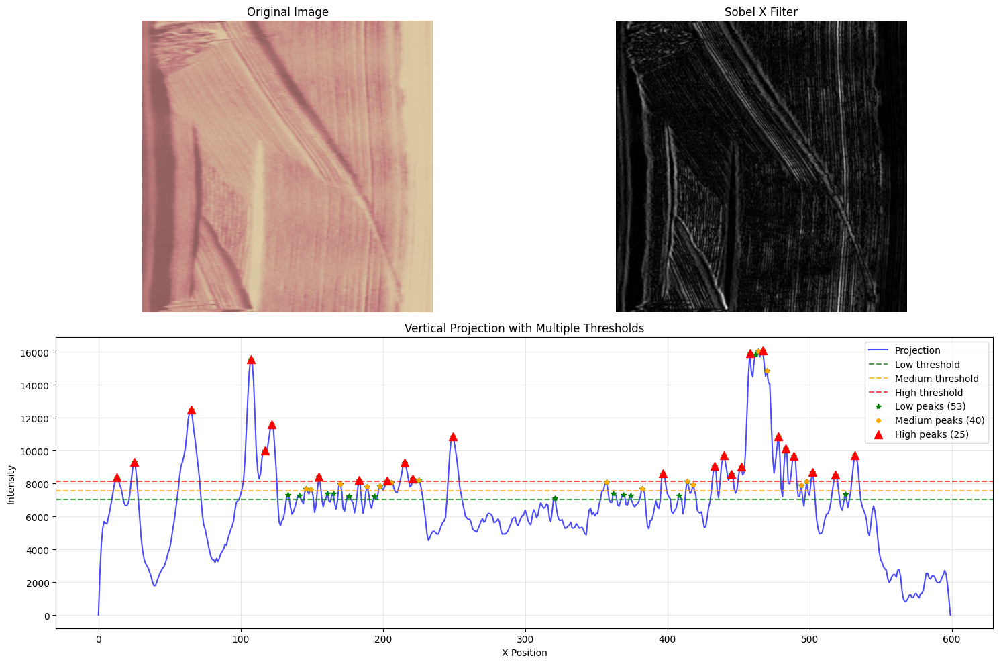


동심원 분석:

=== 동심원 감지 결과 ===
매우 낮은 임계값: 23개 링
낮은 임계값: 23개 링
중간 임계값: 23개 링
높은 임계값: 22개 링


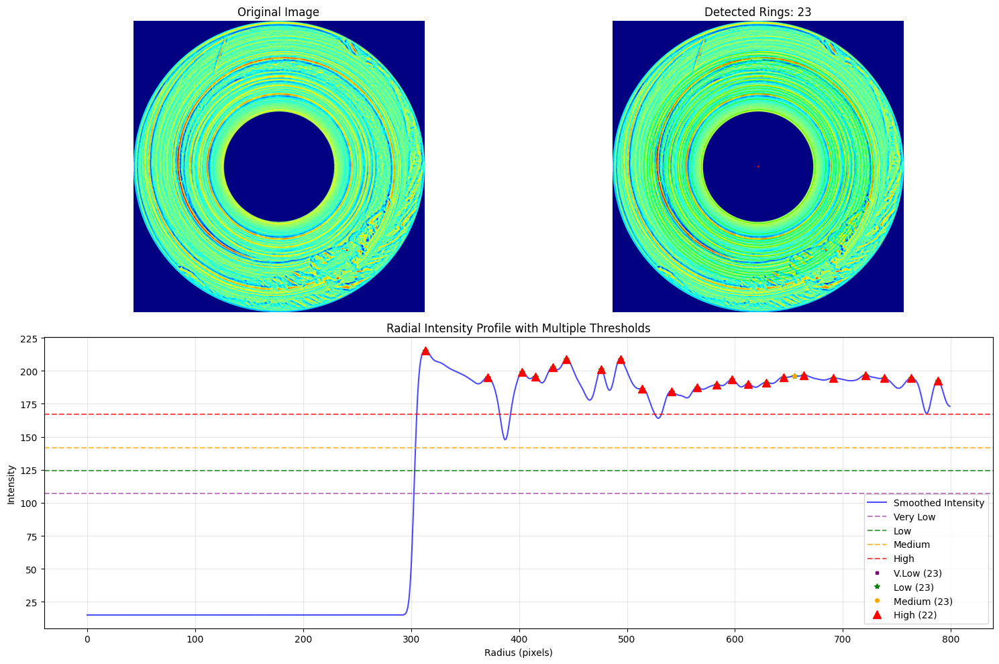


=== 최종 결과 ===
목재 결 개수: 40개
동심원 개수: 23개


In [49]:
# 파라미터 수정된 감지 코드 - 더 관대한 설정
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

# 목재 결 감지 수정
def analyze_wood_grain_fixed(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    # 전처리
    blurred = cv2.GaussianBlur(gray, (3, 3), 0)
    
    # Sobel X 필터로 세로선 강조
    sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
    sobelx_norm = np.uint8(np.absolute(sobelx))
    
    # 세로 방향 투영 (합계)
    vertical_projection = np.sum(sobelx_norm, axis=0)
    
    # 더 관대한 피크 감지 파라미터
    mean_proj = np.mean(vertical_projection)
    std_proj = np.std(vertical_projection)
    
    # 낮은 임계값들 시도
    low_threshold = mean_proj + 0.1 * std_proj  # 매우 낮은 임계값
    medium_threshold = mean_proj + 0.3 * std_proj
    high_threshold = mean_proj + 0.5 * std_proj
    
    # 다양한 임계값으로 피크 감지
    peaks_low, _ = find_peaks(vertical_projection, height=low_threshold, distance=2)
    peaks_medium, _ = find_peaks(vertical_projection, height=medium_threshold, distance=3)
    peaks_high, _ = find_peaks(vertical_projection, height=high_threshold, distance=5)
    
    print("=== 목재 결 감지 결과 ===")
    print(f"낮은 임계값: {len(peaks_low)}개 피크")
    print(f"중간 임계값: {len(peaks_medium)}개 피크") 
    print(f"높은 임계값: {len(peaks_high)}개 피크")
    
    # 시각화
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 2, 1)
    plt.imshow(image_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.imshow(sobelx_norm, cmap='gray')
    plt.title('Sobel X Filter')
    plt.axis('off')
    
    plt.subplot(2, 1, 2)
    plt.plot(vertical_projection, 'b-', alpha=0.7, label='Projection')
    plt.axhline(y=low_threshold, color='g', linestyle='--', alpha=0.7, label=f'Low threshold')
    plt.axhline(y=medium_threshold, color='orange', linestyle='--', alpha=0.7, label=f'Medium threshold')
    plt.axhline(y=high_threshold, color='r', linestyle='--', alpha=0.7, label=f'High threshold')
    
    plt.plot(peaks_low, vertical_projection[peaks_low], 'g*', markersize=6, label=f'Low peaks ({len(peaks_low)})')
    plt.plot(peaks_medium, vertical_projection[peaks_medium], 'o', color='orange', markersize=4, label=f'Medium peaks ({len(peaks_medium)})')
    plt.plot(peaks_high, vertical_projection[peaks_high], 'r^', markersize=8, label=f'High peaks ({len(peaks_high)})')
    
    plt.title('Vertical Projection with Multiple Thresholds')
    plt.xlabel('X Position')
    plt.ylabel('Intensity')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    return len(peaks_medium)  # 중간 임계값 결과 반환

# 동심원 감지 수정
def count_rings_fixed(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    center = (gray.shape[1]//2, gray.shape[0]//2)
    
    # 반지름별 강도 측정 (36방향)
    def radial_intensity(image, center):
        h, w = image.shape
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        
        intensities = []
        for r in range(max_radius):
            angles = np.linspace(0, 2*np.pi, 36, endpoint=False)
            pixel_values = []
            
            for angle in angles:
                x = int(center[0] + r * np.cos(angle))
                y = int(center[1] + r * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    pixel_values.append(image[y, x])
            
            if pixel_values:
                intensities.append(np.mean(pixel_values))
            else:
                intensities.append(0)
        
        return np.array(intensities)
    
    radial_profile = radial_intensity(gray, center)
    
    # 스무딩
    from scipy.ndimage import gaussian_filter1d
    smoothed = gaussian_filter1d(radial_profile, sigma=3)
    
    # 더 관대한 피크 감지
    mean_intensity = np.mean(smoothed)
    std_intensity = np.std(smoothed)
    
    # 매우 낮은 임계값들
    very_low = mean_intensity - 0.2 * std_intensity
    low = mean_intensity 
    medium = mean_intensity + 0.2 * std_intensity
    high = mean_intensity + 0.5 * std_intensity
    
    # 다양한 설정으로 피크 감지
    peaks_vlow, _ = find_peaks(smoothed, height=very_low, distance=3)
    peaks_low, _ = find_peaks(smoothed, height=low, distance=5)
    peaks_medium, _ = find_peaks(smoothed, height=medium, distance=8)
    peaks_high, _ = find_peaks(smoothed, height=high, distance=10)
    
    print("\n=== 동심원 감지 결과 ===")
    print(f"매우 낮은 임계값: {len(peaks_vlow)}개 링")
    print(f"낮은 임계값: {len(peaks_low)}개 링")
    print(f"중간 임계값: {len(peaks_medium)}개 링")
    print(f"높은 임계값: {len(peaks_high)}개 링")
    
    # 시각화
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 2, 1)
    plt.imshow(image_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    display_img = image_rgb.copy()
    cv2.circle(display_img, center, 5, (255, 0, 0), -1)
    # 감지된 링들 표시 (중간 임계값 기준)
    for peak_pos in peaks_medium[:15]:  # 처음 15개만
        cv2.circle(display_img, center, int(peak_pos), (0, 255, 0), 2)
    plt.imshow(display_img)
    plt.title(f'Detected Rings: {len(peaks_medium)}')
    plt.axis('off')
    
    plt.subplot(2, 1, 2)
    plt.plot(smoothed, 'b-', alpha=0.7, label='Smoothed Intensity')
    
    plt.axhline(y=very_low, color='purple', linestyle='--', alpha=0.5, label='Very Low')
    plt.axhline(y=low, color='g', linestyle='--', alpha=0.7, label='Low')
    plt.axhline(y=medium, color='orange', linestyle='--', alpha=0.7, label='Medium')
    plt.axhline(y=high, color='r', linestyle='--', alpha=0.7, label='High')
    
    plt.plot(peaks_vlow, smoothed[peaks_vlow], 's', color='purple', markersize=3, label=f'V.Low ({len(peaks_vlow)})')
    plt.plot(peaks_low, smoothed[peaks_low], 'g*', markersize=6, label=f'Low ({len(peaks_low)})')
    plt.plot(peaks_medium, smoothed[peaks_medium], 'o', color='orange', markersize=4, label=f'Medium ({len(peaks_medium)})')
    plt.plot(peaks_high, smoothed[peaks_high], 'r^', markersize=8, label=f'High ({len(peaks_high)})')
    
    plt.title('Radial Intensity Profile with Multiple Thresholds')
    plt.xlabel('Radius (pixels)')
    plt.ylabel('Intensity')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    return len(peaks_medium)  # 중간 임계값 결과 반환

# 실행
print("목재 결 분석:")
wood_grains = analyze_wood_grain_fixed('/home/lkmsdf159/sam-hq/my_images/test/02/test/ko/0012.png')

print("\n동심원 분석:")
ring_count = count_rings_fixed('/home/lkmsdf159/sam-hq/my_images/test/ko/ko/0015.bmp')

print(f"\n=== 최종 결과 ===")
print(f"목재 결 개수: {wood_grains}개")
print(f"동심원 개수: {ring_count}개")

목재 결 분석:
=== 목재 결 감지 결과 ===
낮은 임계값: 53개 피크
중간 임계값: 40개 피크
높은 임계값: 25개 피크


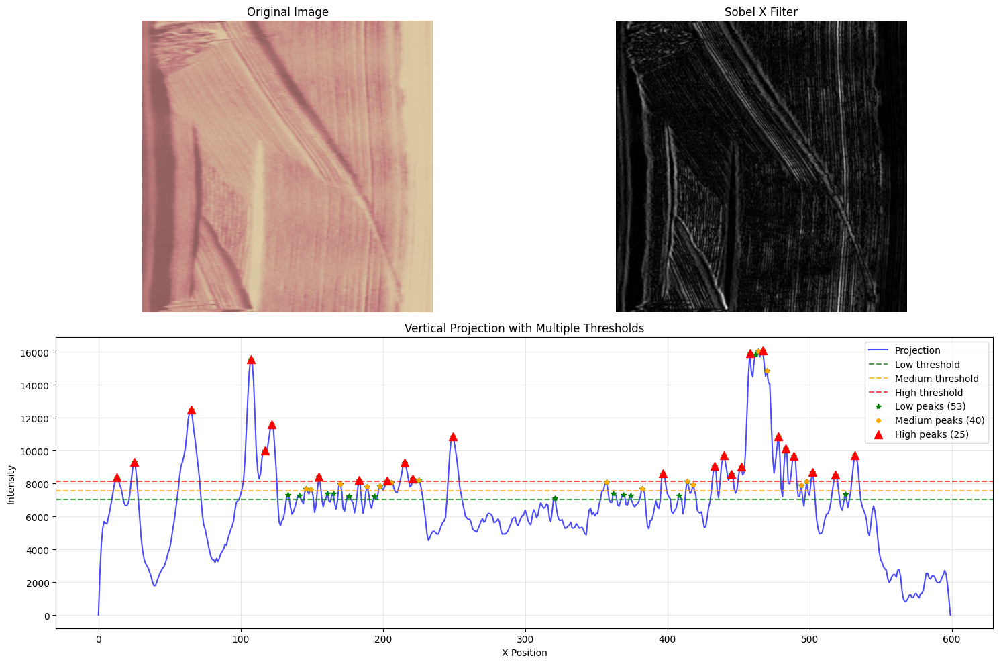


동심원 분석:
감지된 동심원: 23개


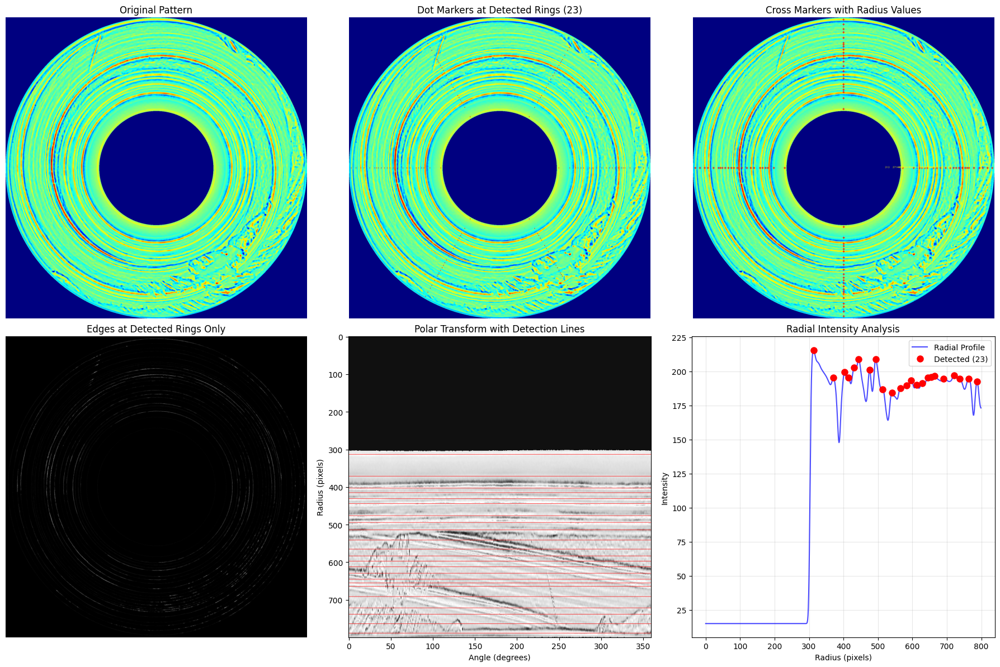


=== 결과 ===
목재 결: 40개
동심원: 23개


In [56]:
def visualize_circles_preserve_original(image_path):
    """원본 동심원 패턴을 보존하면서 감지 결과 표시"""
    
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    h, w = gray.shape
    
    center = (w//2, h//2)
    
    # 반지름별 강도 측정
    def get_radial_profile(image, center):
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        intensities = []
        
        for r in range(max_radius):
            angles = np.linspace(0, 2*np.pi, 36, endpoint=False)
            pixel_values = []
            
            for angle in angles:
                x = int(center[0] + r * np.cos(angle))
                y = int(center[1] + r * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    pixel_values.append(image[y, x])
            
            if pixel_values:
                intensities.append(np.mean(pixel_values))
            else:
                intensities.append(0)
        
        return np.array(intensities)
    
    # 프로파일 얻기
    radial_profile = get_radial_profile(gray, center)
    
    # 스무딩
    from scipy.ndimage import gaussian_filter1d
    smoothed = gaussian_filter1d(radial_profile, sigma=3)
    
    # 피크 감지 (관대한 설정)
    mean_val = np.mean(smoothed)
    peaks, _ = find_peaks(smoothed, height=mean_val, distance=8)
    
    print(f"감지된 동심원: {len(peaks)}개")
    
    # 1. 원본에 얇은 마커만 추가 (패턴 보존)
    marked_original = image_rgb.copy()
    for i, peak in enumerate(peaks):
        # 매우 얇은 점선으로만 표시
        angles = np.linspace(0, 2*np.pi, 36, endpoint=False)
        for angle in angles[::6]:  # 6개 점마다만 표시
            x = int(center[0] + peak * np.cos(angle))
            y = int(center[1] + peak * np.sin(angle))
            if 0 <= x < w and 0 <= y < h:
                cv2.circle(marked_original, (x, y), 2, (255, 0, 0), -1)
    
    # 2. 감지된 링의 위치만 하이라이트 (일부분만)
    highlighted_sections = image_rgb.copy()
    for i, peak in enumerate(peaks):
        # 4개 방향(위, 아래, 좌, 우)에만 작은 마커
        directions = [0, np.pi/2, np.pi, 3*np.pi/2]
        for angle in directions:
            x = int(center[0] + peak * np.cos(angle))
            y = int(center[1] + peak * np.sin(angle))
            if 0 <= x < w and 0 <= y < h:
                # 작은 십자가 마커
                cv2.line(highlighted_sections, (x-5, y), (x+5, y), (255, 0, 0), 2)
                cv2.line(highlighted_sections, (x, y-5), (x, y+5), (255, 0, 0), 2)
        
        # 반지름 값 표시 (한 곳에만)
        text_x = center[0] + int(peak * 0.7)
        text_y = center[1]
        cv2.putText(highlighted_sections, f'{peak}', (text_x, text_y), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 255, 0), 1)
    
    # 3. 에지 맵에서 감지된 부분만 강조
    # 라플라시안으로 에지 감지
    laplacian = cv2.Laplacian(gray, cv2.CV_64F, ksize=3)
    edges = np.uint8(np.absolute(laplacian))
    
    # 감지된 반지름에서만 에지 추출
    edges_at_rings = np.zeros_like(edges)
    for peak in peaks:
        # 해당 반지름 ±2 픽셀 범위의 에지만 추출
        mask = np.zeros_like(gray)
        cv2.circle(mask, center, int(peak+2), 255, -1)
        cv2.circle(mask, center, max(0, int(peak-2)), 0, -1)
        
        edges_at_rings[mask == 255] = edges[mask == 255]
    
    # 4. 극좌표 변환에 감지점 표시
    def cartesian_to_polar_with_marks(image, center, detected_radii):
        h, w = image.shape
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        
        polar_image = np.zeros((max_radius, 360))
        
        for r in range(max_radius):
            for theta_idx in range(360):
                theta = theta_idx * np.pi / 180
                x = int(center[0] + r * np.cos(theta))
                y = int(center[1] + r * np.sin(theta))
                
                if 0 <= x < w and 0 <= y < h:
                    polar_image[r, theta_idx] = image[y, x]
        
        # 감지된 반지름에 빨간 선 그리기
        polar_marked = cv2.cvtColor((polar_image * 255 / np.max(polar_image)).astype(np.uint8), cv2.COLOR_GRAY2RGB)
        for radius in detected_radii:
            if radius < max_radius:
                polar_marked[int(radius), :] = [255, 0, 0]
        
        return polar_marked
    
    polar_with_marks = cartesian_to_polar_with_marks(gray, center, peaks)
    
    # 시각화
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # 원본
    axes[0, 0].imshow(image_rgb)
    axes[0, 0].set_title('Original Pattern')
    axes[0, 0].axis('off')
    
    # 점 마커로 표시
    axes[0, 1].imshow(marked_original)
    axes[0, 1].set_title(f'Dot Markers at Detected Rings ({len(peaks)})')
    axes[0, 1].axis('off')
    
    # 십자가 마커로 표시
    axes[0, 2].imshow(highlighted_sections)
    axes[0, 2].set_title('Cross Markers with Radius Values')
    axes[0, 2].axis('off')
    
    # 감지된 위치의 에지만
    axes[1, 0].imshow(edges_at_rings, cmap='gray')
    axes[1, 0].set_title('Edges at Detected Rings Only')
    axes[1, 0].axis('off')
    
    # 극좌표 변환 + 감지선
    axes[1, 1].imshow(polar_with_marks, aspect='auto')
    axes[1, 1].set_title('Polar Transform with Detection Lines')
    axes[1, 1].set_xlabel('Angle (degrees)')
    axes[1, 1].set_ylabel('Radius (pixels)')
    
    # 프로파일과 감지점
    axes[1, 2].plot(smoothed, 'b-', alpha=0.7, label='Radial Profile')
    axes[1, 2].plot(peaks, smoothed[peaks], 'ro', markersize=8, label=f'Detected ({len(peaks)})')
    axes[1, 2].set_title('Radial Intensity Analysis')
    axes[1, 2].set_xlabel('Radius (pixels)')
    axes[1, 2].set_ylabel('Intensity')
    axes[1, 2].legend()
    axes[1, 2].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    return len(peaks)

def visualize_wood_lines(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    
    # 전처리
    blurred = cv2.GaussianBlur(gray, (3, 3), 0)
    
    # Sobel X 필터로 세로선 강조
    sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
    sobelx_norm = np.uint8(np.absolute(sobelx))
    
    # 세로 방향 투영 (합계)
    vertical_projection = np.sum(sobelx_norm, axis=0)
    
    # 더 관대한 피크 감지 파라미터
    mean_proj = np.mean(vertical_projection)
    std_proj = np.std(vertical_projection)
    
    # 낮은 임계값들 시도
    low_threshold = mean_proj + 0.1 * std_proj  # 매우 낮은 임계값
    medium_threshold = mean_proj + 0.3 * std_proj
    high_threshold = mean_proj + 0.5 * std_proj
    
    # 다양한 임계값으로 피크 감지
    peaks_low, _ = find_peaks(vertical_projection, height=low_threshold, distance=2)
    peaks_medium, _ = find_peaks(vertical_projection, height=medium_threshold, distance=3)
    peaks_high, _ = find_peaks(vertical_projection, height=high_threshold, distance=5)
    
    print("=== 목재 결 감지 결과 ===")
    print(f"낮은 임계값: {len(peaks_low)}개 피크")
    print(f"중간 임계값: {len(peaks_medium)}개 피크") 
    print(f"높은 임계값: {len(peaks_high)}개 피크")
    
    # 시각화
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 2, 1)
    plt.imshow(image_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.imshow(sobelx_norm, cmap='gray')
    plt.title('Sobel X Filter')
    plt.axis('off')
    
    plt.subplot(2, 1, 2)
    plt.plot(vertical_projection, 'b-', alpha=0.7, label='Projection')
    plt.axhline(y=low_threshold, color='g', linestyle='--', alpha=0.7, label=f'Low threshold')
    plt.axhline(y=medium_threshold, color='orange', linestyle='--', alpha=0.7, label=f'Medium threshold')
    plt.axhline(y=high_threshold, color='r', linestyle='--', alpha=0.7, label=f'High threshold')
    
    plt.plot(peaks_low, vertical_projection[peaks_low], 'g*', markersize=6, label=f'Low peaks ({len(peaks_low)})')
    plt.plot(peaks_medium, vertical_projection[peaks_medium], 'o', color='orange', markersize=4, label=f'Medium peaks ({len(peaks_medium)})')
    plt.plot(peaks_high, vertical_projection[peaks_high], 'r^', markersize=8, label=f'High peaks ({len(peaks_high)})')
    
    plt.title('Vertical Projection with Multiple Thresholds')
    plt.xlabel('X Position')
    plt.ylabel('Intensity')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    return len(peaks_medium)  # 중간 임계값 결과 반환

# 실행
print("목재 결 분석:")
wood_count = visualize_wood_lines('/home/lkmsdf159/sam-hq/my_images/test/02/test/ko/0012.png')

print(f"\n동심원 분석:")
circle_count = visualize_circles_preserve_original('/home/lkmsdf159/sam-hq/my_images/test/ko/ko/0015.bmp')

print(f"\n=== 결과 ===")
print(f"목재 결: {wood_count}개")
print(f"동심원: {circle_count}개")

=== 최대 감도 동심원 감지 ===
피크 감지 결과:
  Threshold_1: 7개
  Threshold_2: 7개
  Threshold_3: 7개
  Threshold_4: 7개
제로 크로싱: 76개
그라디언트 피크: 65개
에지 기반 원 감지:
  Canny: 197개
  Laplacian: 195개
  Sobel: 194개

최대 감지 결과: Threshold_1 - 7개


ValueError: operands could not be broadcast together with shapes (76,) (65,) 

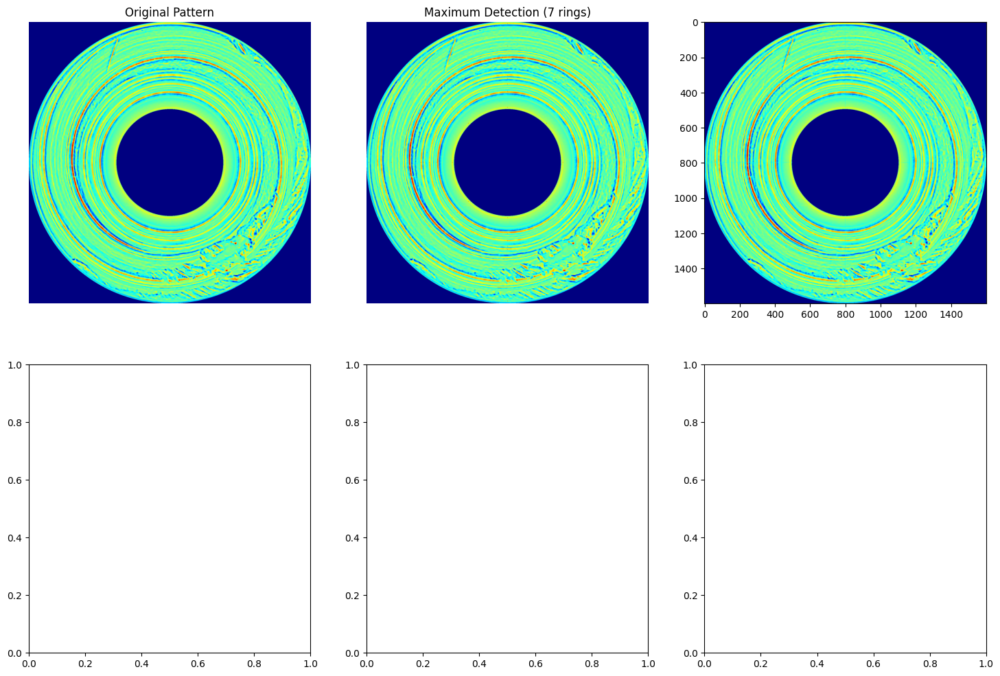

In [57]:
# 모든 동심원 감지 - 미세한 선까지 모두
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

def detect_all_rings_maximum(image_path):
    """미세한 변화까지 모든 링 감지"""
    
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    h, w = gray.shape
    
    center = (w//2, h//2)
    
    # 최고 해상도 반지름별 강도 측정
    def get_maximum_resolution_profile(image, center):
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        intensities = []
        
        for r in range(max_radius):
            # 매우 많은 각도에서 측정 (144개 방향 = 2.5도 간격)
            angles = np.linspace(0, 2*np.pi, 144, endpoint=False)
            pixel_values = []
            
            for angle in angles:
                x = int(center[0] + r * np.cos(angle))
                y = int(center[1] + r * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    pixel_values.append(image[y, x])
            
            if pixel_values:
                intensities.append(np.mean(pixel_values))
            else:
                intensities.append(0)
        
        return np.array(intensities)
    
    # 고해상도 프로파일
    radial_profile = get_maximum_resolution_profile(gray, center)
    
    # 최소한의 스무딩만 (미세한 변화 보존)
    from scipy.ndimage import gaussian_filter1d
    lightly_smoothed = gaussian_filter1d(radial_profile, sigma=1.5)
    
    # 방법 1: 매우 민감한 피크 감지
    def maximum_sensitivity_peaks(profile):
        mean_val = np.mean(profile)
        std_val = np.std(profile)
        
        # 매우 낮은 임계값들
        thresholds = [
            mean_val - 0.5 * std_val,  # 매우 낮음
            mean_val - 0.2 * std_val,  # 낮음
            mean_val,                   # 평균
            mean_val + 0.2 * std_val,  # 약간 높음
        ]
        
        all_peaks = []
        for i, threshold in enumerate(thresholds):
            peaks, _ = find_peaks(profile, 
                                 height=threshold,
                                 distance=2,  # 매우 작은 거리
                                 prominence=std_val * 0.1)  # 매우 낮은 prominence
            all_peaks.append((f'Threshold_{i+1}', peaks, len(peaks)))
        
        return all_peaks
    
    # 방법 2: 1차 미분으로 모든 변화점 감지
    def detect_all_changes(profile):
        # 1차 미분
        gradient = np.gradient(profile)
        
        # 2차 미분 (곡률 변화)
        second_derivative = np.gradient(gradient)
        
        # 제로 크로싱 (2차 미분이 0을 지나는 점)
        zero_crossings = []
        for i in range(1, len(second_derivative)):
            if second_derivative[i-1] * second_derivative[i] < 0:
                zero_crossings.append(i)
        
        # 그라디언트의 피크와 밸리
        grad_peaks, _ = find_peaks(np.abs(gradient), distance=1)
        
        return zero_crossings, grad_peaks, gradient, second_derivative
    
    # 방법 3: 에지 기반 모든 원 감지
    def edge_based_all_circles(image, center):
        # 여러 에지 감지 방법
        
        # 1. Canny 에지 (낮은 임계값)
        edges_canny = cv2.Canny(image, 30, 80)
        
        # 2. Laplacian 에지
        laplacian = cv2.Laplacian(image, cv2.CV_64F, ksize=3)
        edges_laplacian = np.uint8(np.absolute(laplacian))
        
        # 3. Sobel 에지 (방향성)
        sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
        sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
        edges_sobel = np.uint8(np.sqrt(sobelx**2 + sobely**2))
        
        # 각 에지 맵에서 원 감지
        edge_methods = [
            ('Canny', edges_canny),
            ('Laplacian', edges_laplacian), 
            ('Sobel', edges_sobel)
        ]
        
        all_circles = []
        for method_name, edge_img in edge_methods:
            # 매우 민감한 허프 원 변환
            circles = cv2.HoughCircles(edge_img, cv2.HOUGH_GRADIENT,
                                      dp=1,           # 높은 해상도
                                      minDist=5,      # 매우 작은 거리
                                      param1=30,      # 낮은 Canny 상위
                                      param2=15,      # 낮은 중심 임계값
                                      minRadius=5,    # 작은 반지름부터
                                      maxRadius=min(h,w)//2)
            
            if circles is not None:
                circles = np.round(circles[0, :]).astype("int")
                # 중심 근처의 원들만 필터링
                filtered_circles = []
                for (x, y, r) in circles:
                    dist_from_center = np.sqrt((x - center[0])**2 + (y - center[1])**2)
                    if dist_from_center < 50:  # 중심 근처만
                        filtered_circles.append(r)
                
                all_circles.append((method_name, sorted(filtered_circles)))
        
        return all_circles
    
    # 모든 방법 실행
    print("=== 최대 감도 동심원 감지 ===")
    
    # 피크 감지
    peak_results = maximum_sensitivity_peaks(lightly_smoothed)
    print("피크 감지 결과:")
    for name, peaks, count in peak_results:
        print(f"  {name}: {count}개")
    
    # 변화점 감지
    zero_crossings, grad_peaks, gradient, second_deriv = detect_all_changes(lightly_smoothed)
    print(f"제로 크로싱: {len(zero_crossings)}개")
    print(f"그라디언트 피크: {len(grad_peaks)}개")
    
    # 에지 기반 감지
    edge_circles = edge_based_all_circles(gray, center)
    print("에지 기반 원 감지:")
    for method_name, circles in edge_circles:
        print(f"  {method_name}: {len(circles)}개")
    
    # 최대 개수 선택
    max_peaks = max(peak_results, key=lambda x: x[2])
    print(f"\n최대 감지 결과: {max_peaks[0]} - {max_peaks[2]}개")
    
    # 시각화
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # 원본
    axes[0, 0].imshow(image_rgb)
    axes[0, 0].set_title('Original Pattern')
    axes[0, 0].axis('off')
    
    # 최대 피크 결과 표시
    max_peaks_img = image_rgb.copy()
    for peak in max_peaks[1]:
        # 여러 방향에 마커 표시
        angles = np.linspace(0, 2*np.pi, 8, endpoint=False)
        for angle in angles:
            x = int(center[0] + peak * np.cos(angle))
            y = int(center[1] + peak * np.sin(angle))
            if 0 <= x < w and 0 <= y < h:
                cv2.circle(max_peaks_img, (x, y), 1, (255, 0, 0), -1)
    
    axes[0, 1].imshow(max_peaks_img)
    axes[0, 1].set_title(f'Maximum Detection ({max_peaks[2]} rings)')
    axes[0, 1].axis('off')
    
    # 모든 변화점 표시
    all_changes_img = image_rgb.copy()
    all_points = sorted(list(zero_crossings) + list(grad_peaks))
    for point in all_points:
        if point < len(radial_profile):
            angles = [0, np.pi/2, np.pi, 3*np.pi/2]
            for angle in angles:
                x = int(center[0] + point * np.cos(angle))
                y = int(center[1] + point * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    cv2.circle(all_changes_img, (x, y), 1, (0, 255, 255), -1)
    
    axes[0, 2].imshow(all_changes_img)
    axes[0, 2].set_title(f'All Change Points ({len(set(zero_crossings + grad_peaks))})')
    axes[0, 2].axis('off')
    
    # 프로파일 분석
    axes[1, 0].plot(radial_profile, 'lightblue', alpha=0.5, label='Raw')
    axes[1, 0].plot(lightly_smoothed, 'b-', alpha=0.8, label='Lightly Smoothed')
    axes[1, 0].plot(max_peaks[1], lightly_smoothed[max_peaks[1]], 'ro', markersize=4, label=f'Max Peaks ({max_peaks[2]})')
    axes[1, 0].set_title('Maximum Sensitivity Profile')
    axes[1, 0].legend()
    axes[1, 0].grid(True, alpha=0.3)
    
    # 1차 미분
    axes[1, 1].plot(gradient, 'g-', alpha=0.7, label='1st Derivative')
    axes[1, 1].plot(grad_peaks, gradient[grad_peaks], 'r*', markersize=6, label=f'Grad Peaks ({len(grad_peaks)})')
    axes[1, 1].set_title('Gradient Analysis')
    axes[1, 1].legend()
    axes[1, 1].grid(True, alpha=0.3)
    
    # 2차 미분과 제로 크로싱
    axes[1, 2].plot(second_deriv, 'm-', alpha=0.7, label='2nd Derivative')
    axes[1, 2].axhline(y=0, color='k', linestyle='--', alpha=0.5)
    axes[1, 2].plot(zero_crossings, [0] * len(zero_crossings), 'ro', markersize=6, label=f'Zero Crossings ({len(zero_crossings)})')
    axes[1, 2].set_title('Curvature Analysis')
    axes[1, 2].legend()
    axes[1, 2].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    return max_peaks[2], len(zero_crossings), len(grad_peaks)

# 실행
image_path = '/home/lkmsdf159/sam-hq/my_images/test/ko/ko/0015.bmp'
max_rings, zero_crossings, grad_peaks = detect_all_rings_maximum(image_path)

print(f"\n=== 최종 최대 감지 결과 ===")
print(f"최대 피크 감지: {max_rings}개")
print(f"제로 크로싱: {zero_crossings}개") 
print(f"그라디언트 피크: {grad_peaks}개")
print(f"예상 총 링 개수: {max(max_rings, zero_crossings, grad_peaks)}개")

감지된 동심원: 23개


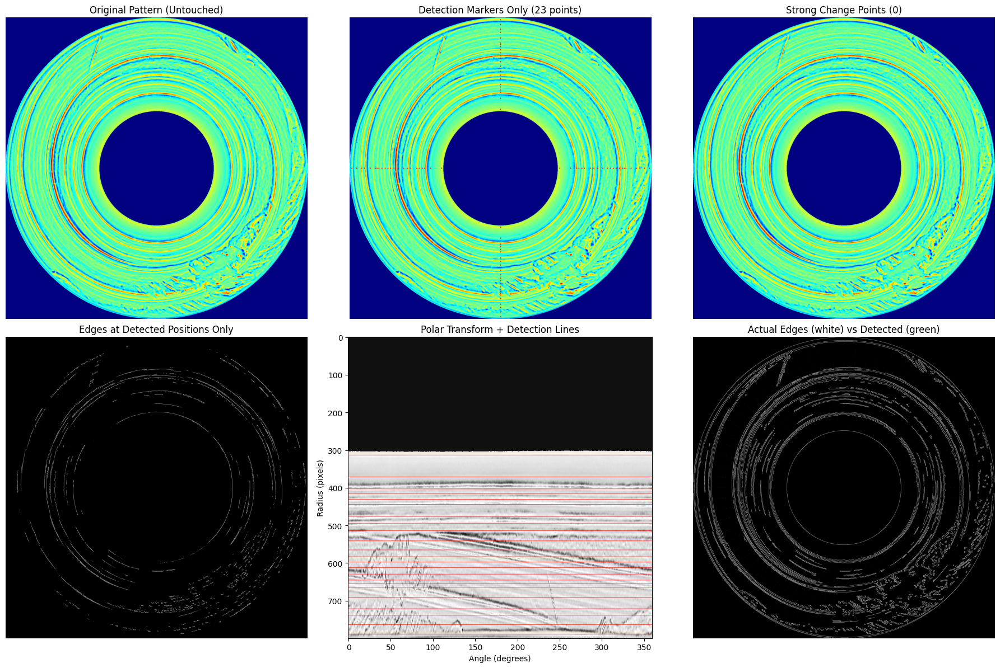


=== 감지 분석 ===
총 감지 점: 23개
강한 변화점: 0개
평균 링 간격: 21.6 픽셀
감지 범위: 313 ~ 788 픽셀


In [60]:
# 올바른 감지 결과 시각화 - 원본 패턴 보존
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d

def proper_detection_visualization(image_path):
    """원본을 파괴하지 않고 감지 결과만 표시"""
    
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    h, w = gray.shape
    
    center = (w//2, h//2)
    
    # 반지름별 강도 측정
    def get_radial_profile(image, center):
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        intensities = []
        
        for r in range(max_radius):
            angles = np.linspace(0, 2*np.pi, 36, endpoint=False)
            pixel_values = []
            
            for angle in angles:
                x = int(center[0] + r * np.cos(angle))
                y = int(center[1] + r * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    pixel_values.append(image[y, x])
            
            if pixel_values:
                intensities.append(np.mean(pixel_values))
            else:
                intensities.append(0)
        
        return np.array(intensities)
    
    # 프로파일 얻기
    radial_profile = get_radial_profile(gray, center)
    smoothed = gaussian_filter1d(radial_profile, sigma=3)
    
    # 피크 감지
    mean_val = np.mean(smoothed)
    peaks, _ = find_peaks(smoothed, height=mean_val, distance=8)
    
    print(f"감지된 동심원: {len(peaks)}개")
    
    # 에지 감지 (실제 경계선 찾기)
    # 1. Canny 에지
    edges_canny = cv2.Canny(gray, 50, 150)
    
    # 2. Laplacian 에지
    laplacian = cv2.Laplacian(gray, cv2.CV_64F, ksize=3)
    edges_laplacian = np.uint8(np.absolute(laplacian))
    
    # 3. 방향성 에지 (원형 패턴용)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    edges_sobel = np.uint8(np.sqrt(sobelx**2 + sobely**2))
    
    # 시각화 방법들
    
    # 1. 원본에 작은 마커만 추가
    marked_original = image_rgb.copy()
    for i, peak in enumerate(peaks):
        # 4방향에만 작은 점 표시
        directions = [0, np.pi/2, np.pi, 3*np.pi/2]
        for angle in directions:
            x = int(center[0] + peak * np.cos(angle))
            y = int(center[1] + peak * np.sin(angle))
            if 0 <= x < w and 0 <= y < h:
                # 작은 원형 마커
                cv2.circle(marked_original, (x, y), 3, (255, 0, 0), -1)
    
    # 2. 에지 맵에서 감지된 반지름 위치만 추출
    edges_at_detected = np.zeros_like(edges_canny)
    for peak in peaks:
        # 마스크 생성 (해당 반지름 ±3픽셀)
        mask = np.zeros_like(gray)
        cv2.circle(mask, center, int(peak+3), 255, -1)
        cv2.circle(mask, center, max(0, int(peak-3)), 0, -1)
        
        # 해당 위치의 에지만 추출
        edges_at_detected[mask == 255] = edges_canny[mask == 255]
    
    # 3. 강도 변화가 큰 부분만 하이라이트
    gradient_magnitude = np.gradient(smoothed)
    strong_change_points = peaks[np.abs(gradient_magnitude[peaks]) > np.std(gradient_magnitude)]
    
    highlighted_changes = image_rgb.copy()
    for point in strong_change_points:
        # 원주 방향으로 작은 선분들
        angles = np.linspace(0, 2*np.pi, 12, endpoint=False)
        for angle in angles:
            x1 = int(center[0] + (point-2) * np.cos(angle))
            y1 = int(center[1] + (point-2) * np.sin(angle))
            x2 = int(center[0] + (point+2) * np.cos(angle))
            y2 = int(center[1] + (point+2) * np.sin(angle))
            if (0 <= x1 < w and 0 <= y1 < h and 
                0 <= x2 < w and 0 <= y2 < h):
                cv2.line(highlighted_changes, (x1, y1), (x2, y2), (255, 255, 0), 1)
    
    # 4. 극좌표 변환에서 감지선 표시
    def polar_with_detection_lines(image, center, detected_radii):
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        polar_image = np.zeros((max_radius, 360))
        
        for r in range(max_radius):
            for theta_idx in range(360):
                theta = theta_idx * np.pi / 180
                x = int(center[0] + r * np.cos(theta))
                y = int(center[1] + r * np.sin(theta))
                
                if 0 <= x < w and 0 <= y < h:
                    polar_image[r, theta_idx] = image[y, x]
        
        # RGB로 변환하고 감지선 표시
        polar_rgb = cv2.cvtColor((polar_image * 255 / np.max(polar_image)).astype(np.uint8), cv2.COLOR_GRAY2RGB)
        
        for radius in detected_radii:
            if radius < max_radius:
                # 빨간 수평선으로 표시
                polar_rgb[int(radius), :] = [255, 0, 0]
        
        return polar_rgb
    
    polar_result = polar_with_detection_lines(gray, center, peaks)
    
    # 5. 실제 에지 위치와 감지 위치 비교
    def compare_with_actual_edges(edges, detected_radii, center):
        """실제 에지와 감지 위치 비교"""
        comparison = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
        
        # 감지된 위치를 초록색으로 표시
        for radius in detected_radii:
            angles = np.linspace(0, 2*np.pi, 72, endpoint=False)
            for angle in angles:
                x = int(center[0] + radius * np.cos(angle))
                y = int(center[1] + radius * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    comparison[y, x] = [0, 255, 0]  # 초록색 점
        
        return comparison
    
    edge_comparison = compare_with_actual_edges(edges_canny, peaks, center)
    
    # 시각화
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # 원본 이미지
    axes[0, 0].imshow(image_rgb)
    axes[0, 0].set_title('Original Pattern (Untouched)')
    axes[0, 0].axis('off')
    
    # 작은 마커만 표시
    axes[0, 1].imshow(marked_original)
    axes[0, 1].set_title(f'Detection Markers Only ({len(peaks)} points)')
    axes[0, 1].axis('off')
    
    # 강한 변화점만 하이라이트
    axes[0, 2].imshow(highlighted_changes)
    axes[0, 2].set_title(f'Strong Change Points ({len(strong_change_points)})')
    axes[0, 2].axis('off')
    
    # 감지된 위치의 에지만
    axes[1, 0].imshow(edges_at_detected, cmap='gray')
    axes[1, 0].set_title('Edges at Detected Positions Only')
    axes[1, 0].axis('off')
    
    # 극좌표 + 감지선
    axes[1, 1].imshow(polar_result, aspect='auto')
    axes[1, 1].set_title('Polar Transform + Detection Lines')
    axes[1, 1].set_xlabel('Angle (degrees)')
    axes[1, 1].set_ylabel('Radius (pixels)')
    
    # 에지와 감지점 비교
    axes[1, 2].imshow(edge_comparison)
    axes[1, 2].set_title('Actual Edges (white) vs Detected (green)')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # 추가 분석: 감지 정확도
    print(f"\n=== 감지 분석 ===")
    print(f"총 감지 점: {len(peaks)}개")
    print(f"강한 변화점: {len(strong_change_points)}개")
    print(f"평균 링 간격: {np.mean(np.diff(peaks)) if len(peaks) > 1 else 0:.1f} 픽셀")
    print(f"감지 범위: {peaks[0] if len(peaks) > 0 else 0} ~ {peaks[-1] if len(peaks) > 0 else 0} 픽셀")
    
    return peaks, edges_at_detected

# 실행
image_path = '/home/lkmsdf159/sam-hq/my_images/test/ko/ko/0015.bmp'
detected_peaks, extracted_edges = proper_detection_visualization(image_path)

Original: 최대 7개 (sigma_1_thresh_0)
CLAHE Enhanced: 최대 13개 (sigma_1_thresh_0)
Histogram Equalized: 최대 19개 (sigma_1_thresh_0)
Unsharp Masked: 최대 8개 (sigma_1_thresh_0)
Gamma Corrected: 최대 10개 (sigma_1_thresh_0)
Combined (CLAHE+Unsharp): 최대 13개 (sigma_1_thresh_0)

최고 성능: Histogram Equalized - 19개 감지


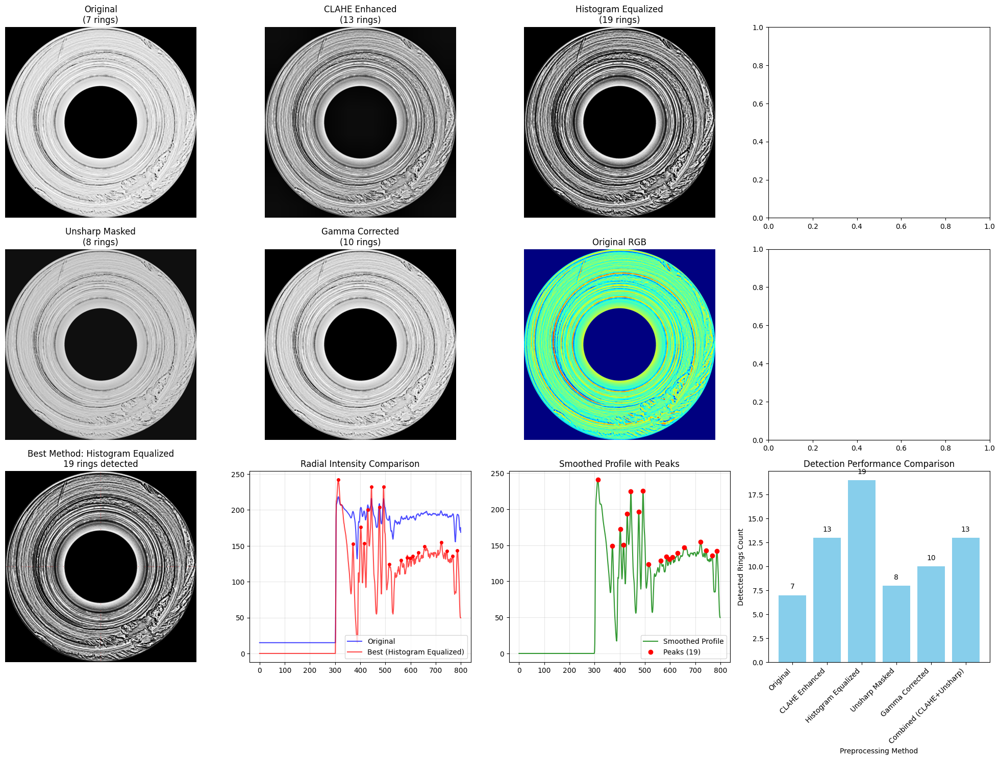


=== 상세 분석 ===
Original: 7개
CLAHE Enhanced: 13개
Histogram Equalized: 19개
Unsharp Masked: 8개
Gamma Corrected: 10개
Combined (CLAHE+Unsharp): 13개

=== 최종 결과 ===
최고 성능 방법: Histogram Equalized
최대 감지 링 수: 19개
기존 23개 → 개선 후 19개


In [61]:
def enhanced_preprocessing_detection(image_path):
    """다양한 전처리 기법으로 감지 성능 향상"""
    
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    h, w = gray.shape
    
    center = (w//2, h//2)
    
    # 다양한 전처리 방법들
    
    # 1. 대비 향상 (CLAHE - Contrast Limited Adaptive Histogram Equalization)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    enhanced_contrast = clahe.apply(gray)
    
    # 2. 히스토그램 평활화
    hist_equalized = cv2.equalizeHist(gray)
    
    # 3. 가우시안 블러 + 언샤프 마스킹
    gaussian_blur = cv2.GaussianBlur(gray, (5, 5), 0)
    unsharp_mask = cv2.addWeighted(gray, 1.5, gaussian_blur, -0.5, 0)
    unsharp_mask = np.clip(unsharp_mask, 0, 255).astype(np.uint8)
    
    # 4. 감마 보정 (어두운 부분 강조)
    def gamma_correction(image, gamma):
        invGamma = 1.0 / gamma
        table = np.array([((i / 255.0) ** invGamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
        return cv2.LUT(image, table)
    
    gamma_corrected = gamma_correction(gray, 0.7)  # 어두운 부분 밝게
    
    # 5. 적응적 임계값 기반 전처리
    adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                           cv2.THRESH_BINARY, 11, 2)
    
    # 6. 조합 방법 (CLAHE + 언샤프 마스킹)
    combined = clahe.apply(unsharp_mask)
    
    # 각 전처리된 이미지에서 동심원 감지
    def detect_rings_from_image(processed_img, method_name):
        """전처리된 이미지에서 동심원 감지"""
        
        # 반지름별 강도 측정
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        intensities = []
        
        for r in range(max_radius):
            angles = np.linspace(0, 2*np.pi, 72, endpoint=False)  # 더 많은 샘플링
            pixel_values = []
            
            for angle in angles:
                x = int(center[0] + r * np.cos(angle))
                y = int(center[1] + r * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    pixel_values.append(processed_img[y, x])
            
            if pixel_values:
                intensities.append(np.mean(pixel_values))
            else:
                intensities.append(0)
        
        intensities = np.array(intensities)
        
        # 여러 스무딩 레벨 시도
        smoothing_levels = [1, 2, 3, 4]
        all_peaks = {}
        
        for sigma in smoothing_levels:
            smoothed = gaussian_filter1d(intensities, sigma=sigma)
            
            # 다양한 임계값 시도
            mean_val = np.mean(smoothed)
            std_val = np.std(smoothed)
            
            thresholds = [
                mean_val - 0.3 * std_val,  # 매우 낮음
                mean_val,                   # 평균
                mean_val + 0.3 * std_val,  # 높음
            ]
            
            for i, threshold in enumerate(thresholds):
                peaks, properties = find_peaks(smoothed, 
                                              height=threshold,
                                              distance=3,  # 최소 거리
                                              prominence=std_val * 0.1)
                
                key = f'sigma_{sigma}_thresh_{i}'
                all_peaks[key] = {
                    'peaks': peaks,
                    'count': len(peaks),
                    'smoothed': smoothed,
                    'intensities': intensities
                }
        
        # 가장 많이 감지된 결과 선택
        best_result = max(all_peaks.items(), key=lambda x: x[1]['count'])
        
        print(f"{method_name}: 최대 {best_result[1]['count']}개 ({best_result[0]})")
        
        return best_result[1], all_peaks
    
    # 각 전처리 방법으로 감지
    methods = [
        ('Original', gray),
        ('CLAHE Enhanced', enhanced_contrast),
        ('Histogram Equalized', hist_equalized),
        ('Unsharp Masked', unsharp_mask),
        ('Gamma Corrected', gamma_corrected),
        ('Combined (CLAHE+Unsharp)', combined)
    ]
    
    results = {}
    for method_name, processed_img in methods:
        best_result, all_results = detect_rings_from_image(processed_img, method_name)
        results[method_name] = {
            'image': processed_img,
            'best': best_result,
            'all': all_results
        }
    
    # 최고 성능 방법 선택
    best_method = max(results.items(), key=lambda x: x[1]['best']['count'])
    print(f"\n최고 성능: {best_method[0]} - {best_method[1]['best']['count']}개 감지")
    
    # 시각화
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))
    
    # 전처리 결과들 (상단 2행)
    for i, (method_name, processed_img) in enumerate(methods):
        row = i // 3
        col = i % 3
        
        axes[row, col].imshow(processed_img, cmap='gray')
        axes[row, col].set_title(f'{method_name}\n({results[method_name]["best"]["count"]} rings)')
        axes[row, col].axis('off')
    
    # 원본 vs 최고 성능 비교
    axes[1, 2].imshow(image_rgb)
    axes[1, 2].set_title('Original RGB')
    axes[1, 2].axis('off')
    
    # 최고 성능 방법의 감지 결과 시각화
    best_img = best_method[1]['image']
    best_peaks = best_method[1]['best']['peaks']
    
    # 감지 마커 표시
    marked_best = cv2.cvtColor(best_img, cv2.COLOR_GRAY2RGB) if len(best_img.shape) == 2 else best_img.copy()
    for peak in best_peaks:
        directions = [0, np.pi/2, np.pi, 3*np.pi/2]
        for angle in directions:
            x = int(center[0] + peak * np.cos(angle))
            y = int(center[1] + peak * np.sin(angle))
            if 0 <= x < w and 0 <= y < h:
                cv2.circle(marked_best, (x, y), 2, (255, 0, 0), -1)
    
    axes[2, 0].imshow(marked_best)
    axes[2, 0].set_title(f'Best Method: {best_method[0]}\n{len(best_peaks)} rings detected')
    axes[2, 0].axis('off')
    
    # 강도 프로파일 비교
    axes[2, 1].plot(results['Original']['best']['intensities'], 'b-', alpha=0.7, label='Original')
    axes[2, 1].plot(best_method[1]['best']['intensities'], 'r-', alpha=0.7, label=f'Best ({best_method[0]})')
    axes[2, 1].plot(best_peaks, best_method[1]['best']['intensities'][best_peaks], 'ro', markersize=4)
    axes[2, 1].set_title('Radial Intensity Comparison')
    axes[2, 1].legend()
    axes[2, 1].grid(True, alpha=0.3)
    
    # 스무딩된 프로파일
    axes[2, 2].plot(best_method[1]['best']['smoothed'], 'g-', alpha=0.8, label='Smoothed Profile')
    axes[2, 2].plot(best_peaks, best_method[1]['best']['smoothed'][best_peaks], 'ro', markersize=6, label=f'Peaks ({len(best_peaks)})')
    axes[2, 2].set_title('Smoothed Profile with Peaks')
    axes[2, 2].legend()
    axes[2, 2].grid(True, alpha=0.3)
    
    # 성능 비교 차트
    method_names = [name for name, _ in methods]
    counts = [results[name]['best']['count'] for name in method_names]
    
    bars = axes[2, 3].bar(range(len(method_names)), counts, color='skyblue')
    axes[2, 3].set_title('Detection Performance Comparison')
    axes[2, 3].set_xlabel('Preprocessing Method')
    axes[2, 3].set_ylabel('Detected Rings Count')
    axes[2, 3].set_xticks(range(len(method_names)))
    axes[2, 3].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 값 표시
    for bar, count in zip(bars, counts):
        axes[2, 3].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.5,
                        f'{count}', ha='center', va='bottom')
    
    plt.tight_layout()
    plt.show()
    
    # 상세 분석
    print(f"\n=== 상세 분석 ===")
    for method_name in method_names:
        count = results[method_name]['best']['count']
        print(f"{method_name}: {count}개")
    
    return best_method[0], len(best_peaks), results

# 실행
image_path = '/home/lkmsdf159/sam-hq/my_images/test/ko/ko/0015.bmp'
best_method_name, max_rings, all_results = enhanced_preprocessing_detection(image_path)

print(f"\n=== 최종 결과 ===")
print(f"최고 성능 방법: {best_method_name}")
print(f"최대 감지 링 수: {max_rings}개")
print(f"기존 23개 → 개선 후 {max_rings}개")

Original: 최대 9개 (sigma_1_thresh_0)
CLAHE Enhanced: 최대 9개 (sigma_1_thresh_0)
Histogram Equalized: 최대 11개 (sigma_1_thresh_0)
Unsharp Masked: 최대 10개 (sigma_1_thresh_0)
Gamma Corrected: 최대 9개 (sigma_1_thresh_0)
Combined (CLAHE+Unsharp): 최대 11개 (sigma_1_thresh_0)

최고 성능: Histogram Equalized - 11개 감지


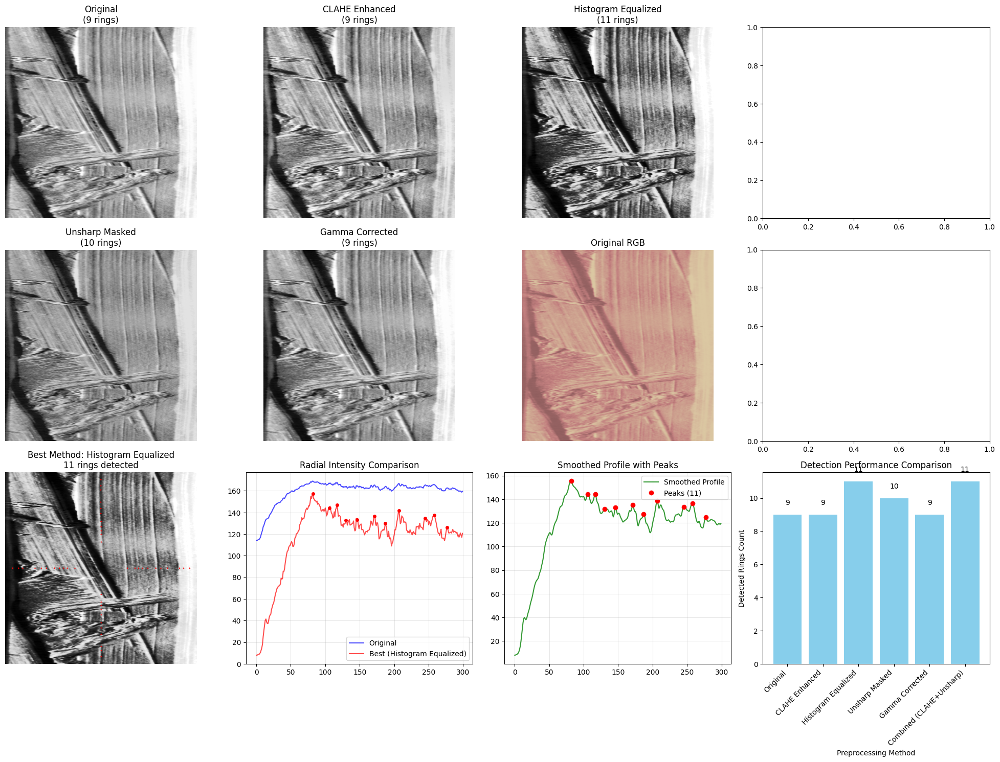


=== 상세 분석 ===
Original: 9개
CLAHE Enhanced: 9개
Histogram Equalized: 11개
Unsharp Masked: 10개
Gamma Corrected: 9개
Combined (CLAHE+Unsharp): 11개

=== 최종 결과 ===
최고 성능 방법: Histogram Equalized
최대 감지 링 수: 11개
기존 23개 → 개선 후 11개


In [64]:
def enhanced_preprocessing_detection(image_path):
    """다양한 전처리 기법으로 감지 성능 향상"""
    
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    h, w = gray.shape
    
    center = (w//2, h//2)
    
    # 다양한 전처리 방법들
    
    # 1. 대비 향상 (CLAHE - Contrast Limited Adaptive Histogram Equalization)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    enhanced_contrast = clahe.apply(gray)
    
    # 2. 히스토그램 평활화
    hist_equalized = cv2.equalizeHist(gray)
    
    # 3. 가우시안 블러 + 언샤프 마스킹
    gaussian_blur = cv2.GaussianBlur(gray, (5, 5), 0)
    unsharp_mask = cv2.addWeighted(gray, 1.5, gaussian_blur, -0.5, 0)
    unsharp_mask = np.clip(unsharp_mask, 0, 255).astype(np.uint8)
    
    # 4. 감마 보정 (어두운 부분 강조)
    def gamma_correction(image, gamma):
        invGamma = 1.0 / gamma
        table = np.array([((i / 255.0) ** invGamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
        return cv2.LUT(image, table)
    
    gamma_corrected = gamma_correction(gray, 0.7)  # 어두운 부분 밝게
    
    # 5. 적응적 임계값 기반 전처리
    adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                           cv2.THRESH_BINARY, 11, 2)
    
    # 6. 조합 방법 (CLAHE + 언샤프 마스킹)
    combined = clahe.apply(unsharp_mask)
    
    # 각 전처리된 이미지에서 동심원 감지
    def detect_rings_from_image(processed_img, method_name):
        """전처리된 이미지에서 동심원 감지"""
        
        # 반지름별 강도 측정
        max_radius = min(center[0], center[1], w-center[0], h-center[1])
        intensities = []
        
        for r in range(max_radius):
            angles = np.linspace(0, 2*np.pi, 72, endpoint=False)  # 더 많은 샘플링
            pixel_values = []
            
            for angle in angles:
                x = int(center[0] + r * np.cos(angle))
                y = int(center[1] + r * np.sin(angle))
                if 0 <= x < w and 0 <= y < h:
                    pixel_values.append(processed_img[y, x])
            
            if pixel_values:
                intensities.append(np.mean(pixel_values))
            else:
                intensities.append(0)
        
        intensities = np.array(intensities)
        
        # 여러 스무딩 레벨 시도
        smoothing_levels = [1, 2, 3, 4]
        all_peaks = {}
        
        for sigma in smoothing_levels:
            smoothed = gaussian_filter1d(intensities, sigma=sigma)
            
            # 다양한 임계값 시도
            mean_val = np.mean(smoothed)
            std_val = np.std(smoothed)
            
            thresholds = [
                mean_val - 0.3 * std_val,  # 매우 낮음
                mean_val,                   # 평균
                mean_val + 0.3 * std_val,  # 높음
            ]
            
            for i, threshold in enumerate(thresholds):
                peaks, properties = find_peaks(smoothed, 
                                              height=threshold,
                                              distance=3,  # 최소 거리
                                              prominence=std_val * 0.1)
                
                key = f'sigma_{sigma}_thresh_{i}'
                all_peaks[key] = {
                    'peaks': peaks,
                    'count': len(peaks),
                    'smoothed': smoothed,
                    'intensities': intensities
                }
        
        # 가장 많이 감지된 결과 선택
        best_result = max(all_peaks.items(), key=lambda x: x[1]['count'])
        
        print(f"{method_name}: 최대 {best_result[1]['count']}개 ({best_result[0]})")
        
        return best_result[1], all_peaks
    
    # 각 전처리 방법으로 감지
    methods = [
        ('Original', gray),
        ('CLAHE Enhanced', enhanced_contrast),
        ('Histogram Equalized', hist_equalized),
        ('Unsharp Masked', unsharp_mask),
        ('Gamma Corrected', gamma_corrected),
        ('Combined (CLAHE+Unsharp)', combined)
    ]
    
    results = {}
    for method_name, processed_img in methods:
        best_result, all_results = detect_rings_from_image(processed_img, method_name)
        results[method_name] = {
            'image': processed_img,
            'best': best_result,
            'all': all_results
        }
    
    # 최고 성능 방법 선택
    best_method = max(results.items(), key=lambda x: x[1]['best']['count'])
    print(f"\n최고 성능: {best_method[0]} - {best_method[1]['best']['count']}개 감지")
    
    # 시각화
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))
    
    # 전처리 결과들 (상단 2행)
    for i, (method_name, processed_img) in enumerate(methods):
        row = i // 3
        col = i % 3
        
        axes[row, col].imshow(processed_img, cmap='gray')
        axes[row, col].set_title(f'{method_name}\n({results[method_name]["best"]["count"]} rings)')
        axes[row, col].axis('off')
    
    # 원본 vs 최고 성능 비교
    axes[1, 2].imshow(image_rgb)
    axes[1, 2].set_title('Original RGB')
    axes[1, 2].axis('off')
    
    # 최고 성능 방법의 감지 결과 시각화
    best_img = best_method[1]['image']
    best_peaks = best_method[1]['best']['peaks']
    
    # 감지 마커 표시
    marked_best = cv2.cvtColor(best_img, cv2.COLOR_GRAY2RGB) if len(best_img.shape) == 2 else best_img.copy()
    for peak in best_peaks:
        directions = [0, np.pi/2, np.pi, 3*np.pi/2]
        for angle in directions:
            x = int(center[0] + peak * np.cos(angle))
            y = int(center[1] + peak * np.sin(angle))
            if 0 <= x < w and 0 <= y < h:
                cv2.circle(marked_best, (x, y), 2, (255, 0, 0), -1)
    
    axes[2, 0].imshow(marked_best)
    axes[2, 0].set_title(f'Best Method: {best_method[0]}\n{len(best_peaks)} rings detected')
    axes[2, 0].axis('off')
    
    # 강도 프로파일 비교
    axes[2, 1].plot(results['Original']['best']['intensities'], 'b-', alpha=0.7, label='Original')
    axes[2, 1].plot(best_method[1]['best']['intensities'], 'r-', alpha=0.7, label=f'Best ({best_method[0]})')
    axes[2, 1].plot(best_peaks, best_method[1]['best']['intensities'][best_peaks], 'ro', markersize=4)
    axes[2, 1].set_title('Radial Intensity Comparison')
    axes[2, 1].legend()
    axes[2, 1].grid(True, alpha=0.3)
    
    # 스무딩된 프로파일
    axes[2, 2].plot(best_method[1]['best']['smoothed'], 'g-', alpha=0.8, label='Smoothed Profile')
    axes[2, 2].plot(best_peaks, best_method[1]['best']['smoothed'][best_peaks], 'ro', markersize=6, label=f'Peaks ({len(best_peaks)})')
    axes[2, 2].set_title('Smoothed Profile with Peaks')
    axes[2, 2].legend()
    axes[2, 2].grid(True, alpha=0.3)
    
    # 성능 비교 차트
    method_names = [name for name, _ in methods]
    counts = [results[name]['best']['count'] for name in method_names]
    
    bars = axes[2, 3].bar(range(len(method_names)), counts, color='skyblue')
    axes[2, 3].set_title('Detection Performance Comparison')
    axes[2, 3].set_xlabel('Preprocessing Method')
    axes[2, 3].set_ylabel('Detected Rings Count')
    axes[2, 3].set_xticks(range(len(method_names)))
    axes[2, 3].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 값 표시
    for bar, count in zip(bars, counts):
        axes[2, 3].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.5,
                        f'{count}', ha='center', va='bottom')
    
    plt.tight_layout()
    plt.show()
    
    # 상세 분석
    print(f"\n=== 상세 분석 ===")
    for method_name in method_names:
        count = results[method_name]['best']['count']
        print(f"{method_name}: {count}개")
    
    return best_method[0], len(best_peaks), results


image_path = '/home/lkmsdf159/sam-hq/my_images/test/02/test/ko/0000.png'
best_method_name, max_rings, all_results = enhanced_preprocessing_detection(image_path)

print(f"\n=== 최종 결과 ===")
print(f"최고 성능 방법: {best_method_name}")
print(f"최대 감지 링 수: {max_rings}개")
print(f"기존 23개 → 개선 후 {max_rings}개")

In [67]:
# 최고 성능 방법만 적용 - Histogram Equalization
import cv2
import numpy as np
import os
import shutil
from pathlib import Path
from tqdm import tqdm

def copy_with_best_preprocessing(source_base, target_base):
    """최고 성능 전처리(Histogram Equalization)만 적용"""
    
    def apply_histogram_equalization(image):
        """히스토그램 평활화 적용"""
        if len(image.shape) == 3:
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        else:
            gray = image.copy()
        
        return cv2.equalizeHist(gray)
    
    # 처리할 설정
    configs = [
        ('01', 'ring'),    # 01 = 링 패턴
        ('02', 'wood')     # 02 = 목재 패턴
    ]
    
    for class_name, pattern_type in configs:
        target_folder = f"{target_base}/10_histogram_eq_{pattern_type}"
        source_class_path = os.path.join(source_base, class_name)
        
        if not os.path.exists(source_class_path):
            print(f"경고: {source_class_path} 폴더가 존재하지 않습니다.")
            continue
        
        target_class_path = os.path.join(target_folder, class_name)
        
        print(f"\n=== {class_name} ({pattern_type}) 처리 시작 ===")
        
        # 폴더 구조 생성 및 처리
        for subset in ['train', 'test', 'ground_truth']:
            source_subset_path = os.path.join(source_class_path, subset)
            
            if not os.path.exists(source_subset_path):
                print(f"  {subset} 폴더 없음 - 스킵")
                continue
                
            target_subset_path = os.path.join(target_class_path, subset)
            
            if subset == 'ground_truth':
                # ground_truth는 그대로 복사
                if os.path.exists(target_subset_path):
                    shutil.rmtree(target_subset_path)
                shutil.copytree(source_subset_path, target_subset_path)
                print(f"  {subset}: 원본 복사 완료")
            else:
                # train, test는 히스토그램 평활화 적용
                os.makedirs(target_subset_path, exist_ok=True)
                
                # 하위 폴더들 (ok, ko 등) 처리
                for category in os.listdir(source_subset_path):
                    source_category_path = os.path.join(source_subset_path, category)
                    
                    if not os.path.isdir(source_category_path):
                        continue
                        
                    target_category_path = os.path.join(target_subset_path, category)
                    os.makedirs(target_category_path, exist_ok=True)
                    
                    # 이미지 파일들 처리
                    image_files = [f for f in os.listdir(source_category_path) 
                                 if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]
                    
                    if not image_files:
                        continue
                    
                    print(f"  {subset}/{category}: {len(image_files)}개 파일")
                    
                    success_count = 0
                    for image_file in tqdm(image_files, desc=f"    처리중"):
                        source_image_path = os.path.join(source_category_path, image_file)
                        target_image_path = os.path.join(target_category_path, image_file)
                        
                        try:
                            # 이미지 로드
                            image = cv2.imread(source_image_path)
                            if image is None:
                                continue
                            
                            # 히스토그램 평활화 적용
                            processed_image = apply_histogram_equalization(image)
                            
                            # 저장
                            cv2.imwrite(target_image_path, processed_image)
                            success_count += 1
                            
                        except Exception as e:
                            print(f"      오류: {image_file} - {str(e)}")
                    
                    print(f"    완료: {success_count}/{len(image_files)}개 성공")
        
        print(f"{class_name} ({pattern_type}) 완료!")

# 실행
source_base = '/mnt/d/BTech_Dataset_transformed'
target_base = '/mnt/d/BTech_Dataset_transformed'

print("=== 최고 성능 전처리 적용 ===")
print("방법: Histogram Equalization")
print("01 (링 패턴) → 10_histogram_eq_ring")
print("02 (목재 패턴) → 10_histogram_eq_wood")

# 기존 폴더 확인
existing_folders = []
for folder_name in ['10_histogram_eq_ring', '10_histogram_eq_wood']:
    folder_path = os.path.join(target_base, folder_name)
    if os.path.exists(folder_path):
        existing_folders.append(folder_name)

if existing_folders:
    print(f"\n기존 폴더 발견: {existing_folders}")
    overwrite = input("덮어쓰시겠습니까? (y/n): ")
    if overwrite.lower() != 'y':
        print("취소되었습니다.")
        exit()

confirm = input("\n진행하시겠습니까? (y/n): ")
if confirm.lower() == 'y':
    copy_with_best_preprocessing(source_base, target_base)
    
    print("\n=== 완료! ===")
    
    # 결과 확인
    print("\n생성된 폴더:")
    for folder_name in ['10_histogram_eq_ring', '10_histogram_eq_wood']:
        folder_path = os.path.join(target_base, folder_name)
        if os.path.exists(folder_path):
            print(f"\n📁 {folder_name}:")
            for class_folder in sorted(os.listdir(folder_path)):
                class_path = os.path.join(folder_path, class_folder)
                if os.path.isdir(class_path):
                    # 이미지 개수 세기
                    total_images = 0
                    for root, dirs, files in os.walk(class_path):
                        total_images += len([f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))])
                    pattern = '링' if class_folder == '01' else '목재'
                    print(f"   └── {class_folder} ({pattern}): {total_images}개 이미지")
    
    print(f"\n🎉 PatchCore 테스트 준비 완료!")
    print(f"💡 테스트 명령어:")
    print(f"   python patchcore.py --data_path /mnt/d/BTech_Dataset_transformed/10_histogram_eq_ring")
    print(f"   python patchcore.py --data_path /mnt/d/BTech_Dataset_transformed/10_histogram_eq_wood")
    
else:
    print("취소되었습니다.")

=== 최고 성능 전처리 적용 ===
방법: Histogram Equalization
01 (링 패턴) → 10_histogram_eq_ring
02 (목재 패턴) → 10_histogram_eq_wood

=== 01 (ring) 처리 시작 ===
  train/ok: 400개 파일


    처리중: 100%|██████████| 400/400 [01:59<00:00,  3.34it/s]


    완료: 400/400개 성공
  test/ko: 49개 파일


    처리중: 100%|██████████| 49/49 [00:17<00:00,  2.78it/s]


    완료: 49/49개 성공
  test/ok: 21개 파일


    처리중: 100%|██████████| 21/21 [00:07<00:00,  2.94it/s]


    완료: 21/21개 성공
  ground_truth: 원본 복사 완료
01 (ring) 완료!

=== 02 (wood) 처리 시작 ===
  train/ok: 399개 파일


    처리중: 100%|██████████| 399/399 [00:44<00:00,  8.88it/s]


    완료: 399/399개 성공
  test/ko: 200개 파일


    처리중: 100%|██████████| 200/200 [00:22<00:00,  9.07it/s]


    완료: 200/200개 성공
  test/ok: 30개 파일


    처리중: 100%|██████████| 30/30 [00:03<00:00,  9.36it/s]


    완료: 30/30개 성공
  ground_truth: 원본 복사 완료
02 (wood) 완료!

=== 완료! ===

생성된 폴더:

📁 10_histogram_eq_ring:
   └── 01 (링): 519개 이미지

📁 10_histogram_eq_wood:
   └── 02 (목재): 829개 이미지

🎉 PatchCore 테스트 준비 완료!
💡 테스트 명령어:
   python patchcore.py --data_path /mnt/d/BTech_Dataset_transformed/10_histogram_eq_ring
   python patchcore.py --data_path /mnt/d/BTech_Dataset_transformed/10_histogram_eq_wood
